In [1]:
import logging
logging.getLogger('matplotlib.font_manager').setLevel(logging.ERROR)
import palantir
import scanpy as sc
import scvelo as scv
import cellrank as cr
import scvi
import phate
import plotly.express as px
import numpy as np
from dash import Dash, dcc, html, Input, Output
scvi.settings.seed = 1995
from anndata import AnnData
import time

import pandas as pd

import os
import sys
os.environ['R_HOME'] = sys.exec_prefix+"/lib/R/"

# Plotting
import matplotlib
import matplotlib.pyplot as plt
import matplotlib as mpl

from copy import copy
reds = copy(mpl.cm.Reds)
reds.set_under("lightgray")

def matplotlib_to_plotly(cmap, pl_entries):
    h = 1.0/(pl_entries-1)
    pl_colorscale = []

    for k in range(pl_entries):
        C = list(map(np.uint8, np.array(cmap(k * h)[:3]) * 255))
        pl_colorscale.append([k*h, 'rgb'+str((C[0], C[1], C[2]))])

    return pl_colorscale

plotly_reds = matplotlib_to_plotly(reds, 255)
plotly_reds[0] = [0.0, 'rgb(211, 211, 211)']
sc.set_figure_params(dpi=50,figsize=[6,4])

# Inline plotting
%matplotlib inline

project_directory = '/Cranio_Lab/Louk_Seton/mesenchyme_project_2023'
os.chdir(os.path.expanduser("~")+project_directory)

Global seed set to 1995


In [2]:
###custom functions
from typing import TYPE_CHECKING, Literal, get_args
_Method = Literal["logreg", "t-test", "wilcoxon", "t-test_overestim_var"]
def plot_deg_embedding(
    adata: AnnData,
    method: _Method,
    groupby: str = 'leiden',
    key_added: str | None = None,
    cluster_name: str = '0',
    n_genes: int = 100,
    basis: str = 'X_scvi_MDE',
) -> AnnData | None:
    avail_methods = set(get_args(_Method))
    if method not in avail_methods:
        raise ValueError(f"Method must be one of {avail_methods}.")
    
    if key_added is None:
        key_added = "rank_genes_groups_"+method
    
    sc.set_figure_params(dpi=50,figsize=[6,4]) #small figures otherwise your notebook will crash
    sc.tl.rank_genes_groups(adata, groupby = groupby, method=method, key_added = key_added)
    genes = adata.uns[key_added]['names'][cluster_name][:n_genes].tolist()
    sc.pl.embedding(adata,
                    basis=basis,
                    color=[groupby]+genes,
                    frameon=False,
                    groups=cluster_name,
                    ncols=4,
                    cmap = reds,
                    vmin=0.1,
                   )

def scvi_anndata_test(
    adata: AnnData,
    batch_key: str = 'batch',
    continuous_covariate_keys: list = ['S_score','G2M_score'],
    layer: str='original_counts',
    n_latent: int = 20,
    n_layers: int = 1,
    max_epochs: int = 500,
    n_neighbors: int = 15,
    resolution: int = 1,
    key_added: str | None = None,
    leiden_key: str = 'leiden_scvi',
) -> AnnData | None:
    if adata.is_view:  # we shouldn't need this here...
        adata._init_as_actual(adata.copy())
    
    if key_added is None:
        latent_key = "X_scvi"
        mde_key = "X_scvi_MDE"
    else:
        latent_key = key_added + "_scvi"
        mde_key = key_added + "_scvi_MDE"
    
    scvi.model.SCVI.setup_anndata(adata, #anndata object
                                  batch_key = batch_key, #categorical key for batch correction
                                  continuous_covariate_keys = continuous_covariate_keys,
                                                                #'total_counts',
                                                                #'pct_counts_mt',
                                                                #continuous key for cell cycle correction
                                  layer = layer) #layer with unmodified counts
    
    adata_model = scvi.model.SCVI(adata,
                                  n_latent = n_latent, #n_latent number of dimensions in latent space (think PCA but different)
                                  n_layers = n_layers, #n_layers number of layers in the neural network
                                 )
    
    print(adata_model.view_anndata_setup(adata))
    
    
    adata_model.train(
        max_epochs = max_epochs, #change how many runs it should train on
    )
    
    adata.obsm[latent_key] = adata_model.get_latent_representation()
    
    sc.pp.neighbors(adata,  #name of anndata object
                    n_neighbors = n_neighbors,
                    use_rep = latent_key,
                   )
    sc.tl.leiden(adata, #name of anndata object
                 resolution = resolution,
                 key_added = leiden_key
                )
    
    adata.obsm[mde_key] = scvi.model.utils.mde(adata.obsm[latent_key])  
    sc.pl.embedding(adata,
                    basis=mde_key,
                    color = [leiden_key,batch_key,'phase',],
                    ncols=3, cmap=reds, vmin=0.3)

    
    
from anndata import AnnData
def harmony_integrate_pipe(
    adata: AnnData, #input anndata object
    layer: str = 'original_counts', #layer with unmodified counts
    target_sum: int = 1e4, #target sum for normalization
    max_value: int = 10, #max value for scaling
    batch_key: str = 'batch', #batch key
    rep_key: str = 'X_pca_harmony', #adjusted harmony pca
    mde_key: str = 'X_harmony_MDE', #mde embedding key
    resolution: int = 0.5, #leiden resolution for quick plot
    leiden_key: str = 'leiden_harmony',
) -> AnnData | None:
    if adata.is_view:  # we shouldn't need this here...
        adata._init_as_actual(adata.copy())
    
    adata.X = adata.layers[layer].copy()
    try:
        del adata.uns['log1p']
    except:
        print('no log1p')
    
    sc.pp.normalize_total(adata, target_sum=target_sum)
    sc.pp.log1p(adata)
    sc.pp.scale(adata, max_value=max_value)
    sc.tl.pca(adata)
    sc.external.pp.harmony_integrate(adata,key = batch_key, adjusted_basis  = rep_key)
    sc.pp.neighbors(adata, use_rep = rep_key)
    adata.obsm[mde_key] = scvi.model.utils.mde(adata.obsm[rep_key])
    sc.tl.leiden(adata,resolution = resolution,key_added = leiden_key)
    sc.pl.embedding(adata,
                    basis=mde_key,
                    color = [leiden_key,batch_key,'phase',],
                    ncols=3, cmap=reds, vmin=0.3)

def default_processing_to_mde(
    adata: AnnData, #input anndata object
    layer: str = 'original_counts', #layer with unmodified counts
    target_sum: int = 1e4, #target sum for normalization
    max_value: int = 10, #max value for scaling
    n_neighbors: int = 15,
    n_pcs: int = 30,
    mde_key: str = 'X_MDE', #mde embedding key
    resolution: int = 0.5, #leiden resolution for quick plot
    leiden_key: str = 'leiden_default',
) -> AnnData | None:
    if adata.is_view:  # we shouldn't need this here...
        adata._init_as_actual(adata.copy())
    
    adata.X = adata.layers[layer].copy()
    try:
        del adata.uns['log1p']
    except:
        print('no log1p')
    
    sc.pp.normalize_total(adata, target_sum=target_sum)
    sc.pp.log1p(adata)
    sc.pp.scale(adata, max_value=max_value)
    sc.tl.pca(adata)
    sc.pp.neighbors(adata, n_neighbors = n_neighbors, n_pcs = n_pcs)
    adata.obsm[mde_key] = scvi.model.utils.mde(adata.obsm['X_pca'])
    sc.tl.leiden(adata,resolution = resolution,key_added = leiden_key)
    sc.pl.embedding(adata,
                    basis=mde_key,
                    color = [leiden_key,'phase',],
                    ncols=3, cmap=reds, vmin=0.3)
    
def score_cell_cycle_mouse(
    adata: AnnData,
) -> AnnData | None:
    cell_cycle_genes = ['Mcm5','Pcna','Tyms','Fen1','Mcm2','Mcm4','Rrm1','Ung','Gins2','Mcm6',
                    'Cdca7','Dtl','Prim1','Uhrf1','Cenpu','Hells','Rfc2','Rpa2','Nasp',
                    'Rad51ap1','Gmnn','Wdr76','Slbp','Ccne2','Ubr7','Pold3','Msh2','Atad2',
                    'Rad51','Rrm2','Cdc45','Cdc6','Exo1','Tipin','Dscc1','Blm','Casp8ap2',
                    'Usp1','Clspn','Pola1','Chaf1b','Brip1','E2f8','Hmgb2','Cdk1','Nusap1',
                    'Ube2c','Birc5','Tpx2','Top2a','Ndc80','Cks2','Nuf2','Cks1b','Mki67',
                    'Tmpo','Cenpf','Tacc3','Pimreg','Smc4','Ccnb2','Ckap2l','Ckap2','Aurkb',
                    'Bub1','Kif11','Anp32e','Tubb4b','Gtse1','Kif20b','Hjurp','Cdca3',
                    'Jpt1','Cdc20','Ttk','Cdc25c','Kif2c','Rangap1','Ncapd2','Dlgap5',
                    'Cdca2','Cdca8','Ect2','Kif23','Hmmr','Aurka','Psrc1','Anln','Lbr',
                    'Ckap5','Cenpe','Ctcf','Nek2','G2e3','Gas2l3','Cbx5','Cenpa',
                   ]
    s_genes = cell_cycle_genes[:43]
    g2m_genes = cell_cycle_genes[43:]
    cell_cycle_genes = s_genes + g2m_genes
    cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]
    len(cell_cycle_genes)
    sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

def default_regress_cycle_to_mde(
    adata: AnnData, #input anndata object
    layer: str = 'original_counts', #layer with unmodified counts
    target_sum: int = 1e4, #target sum for normalization
    max_value: int = 10, #max value for scaling
    use_hvg_genes: bool = True, 
    n_top_genes: int = 3000, #number of top genes
    n_comps: int = 50, #comps of pca to calculate
    n_neighbors: int = 15,
    mde_key: str = 'X_MDE', #mde embedding key
    resolution: int = 0.5, #leiden resolution for quick plot
    leiden_key: str = 'leiden_default',
    skip_preprocess: bool = False
) -> AnnData | None:
    if adata.is_view:  # we shouldn't need this here...
        adata._init_as_actual(adata.copy())
    if skip_preprocess is False:
        adata.X = adata.layers[layer].copy()
        try:
            del adata.uns['log1p']
        except:
            print('no log1p')
    
        sc.pp.normalize_total(adata, target_sum=target_sum)
        sc.pp.log1p(adata)
        sc.pp.scale(adata, max_value=max_value)
        if not 'phase' in adata.obs:
            print('cell cycle not scored, scoring now')
            score_cell_cycle_mouse(adata)
        print(str(time.time())+': Regressing cell cycle')
        sc.pp.regress_out(adata, ['S_score', 'G2M_score'])
    print(str(time.time())+': Highly Variable Genes')
    if use_hvg_genes is True:
        sc.pp.highly_variable_genes(adata, layer = layer, n_top_genes = n_top_genes, flavor = 'seurat_v3')
        
    print(str(time.time())+': PCA')
    sc.tl.pca(adata, n_comps=n_comps)
    print(str(time.time())+': Neighbors')
    sc.pp.neighbors(adata, n_neighbors = n_neighbors)
    print(str(time.time())+': MDE and UMAP')
    sc.tl.umap(adata),
    adata.obsm[mde_key] = scvi.model.utils.mde(adata.obsm['X_pca'])
    print(str(time.time())+': Leiden clustering')
    sc.tl.leiden(adata,resolution = resolution,key_added = leiden_key)
    sc.pl.embedding(adata,
                    basis=mde_key,
                    color = [leiden_key,'phase',],
                    ncols=3, cmap=reds, vmin=0.3)
    sc.pl.embedding(adata,
                    basis='X_umap',
                    color = [leiden_key,'phase',],
                    ncols=3, cmap=reds, vmin=0.3)

In [3]:
# adata = sc.read('anndata_objects/dataset_cleaned.h5ad')
# adata.layers['original_counts'] = adata.X.copy()

In [4]:
#adata.write('anndata_objects/dataset_cleaned.h5ad')

In [5]:
# adata_E11 = adata[adata.obs['stage']=='11'].copy()
# adata_E11.X = adata_E11.layers['original_counts'].copy()
# try:
#     del adata_E11.uns['log1p']
# except:
#   print("no log1p")

no log1p


In [6]:
# sc.pp.normalize_total(adata_E11, target_sum=1e4)
# sc.pp.log1p(adata_E11)
# #sc.pp.scale(adata, max_value=10)
# #adata = batch_scale(adata)
# cell_cycle_genes = [x.strip() for x in open('regev_lab_cell_cycle_genes.txt')]
# s_genes = cell_cycle_genes[:43]
# g2m_genes = cell_cycle_genes[43:]
# cell_cycle_genes = s_genes + g2m_genes


# cell_cycle_genes = [x for x in cell_cycle_genes if x in adata_E11.var_names]
# len(cell_cycle_genes)
# sc.tl.score_genes_cell_cycle(adata_E11, s_genes=s_genes, g2m_genes=g2m_genes)

In [42]:
# scvi.model.SCVI.setup_anndata(adata_E11, #anndata object
#                               batch_key = 'batch', #categorical key for batch correction
#                               continuous_covariate_keys = ['S_score', 'G2M_score',
#                                                            #'total_counts',
#                                                            #'pct_counts_mt',
#                                                           ], #continuous key for cell cycle correction
#                               layer = 'original_counts') #layer with unmodified counts
# adata_E11_model = scvi.model.SCVI(adata_E11,
#                                   n_latent = 40, 
#                                   #n_layers = 2,
#                                  ) #n_latent number of dimensions in latent space (think PCA but different)
#                                                                 #n_layers number of layers in the neural network
# adata_E11_model.view_anndata_setup(adata_E11) #view model configuration
# adata_E11_model.train(
#     max_epochs = 500
# ) #change how many runs it should train on
# #latent space parameters, layers and epochs affect the final representation. They should be tuned to get a desired representation.
# #make them too high and things will overfit, too low and things will underfit
# adata_E11.obsm['X_scvi'] = adata_E11_model.get_latent_representation() #add latent space to anndata object 

# #calculate neighbors using scvi latent space instead of a pca
# sc.pp.neighbors(adata_E11,  #name of anndata object
#                 use_rep = 'X_scvi')
# #clustering
# #key added variable is the name of the column that is added
# #if empty it will overwrite the 'leiden' column
# sc.tl.leiden(adata_E11, #name of anndata object
#              resolution = 1)
# adata_E11.obsm['X_scvi_MDE'] = scvi.model.utils.mde(adata_E11.obsm['X_scvi'])

#adata_E11.write('anndata_objects/adata_E11_integrated.h5ad')
adata_E11 = sc.read('anndata_objects/adata_E11_integrated.h5ad')

In [ ]:
#keep cluster 0,1,2,3,4,6,7,11 for ectomesen, have to filter some more after
sc.set_figure_params(dpi=50,figsize=[6,4])
sc.pl.embedding(
    adata_E11,
    basis='X_scvi_MDE',
    color=['leiden','batch','phase',
           'Sox10','Mpz','Plp1','Tlx2','Sox9','Pmp22',
           'Prrx2','Tfap2b','Dlx2',
           'Egfl7', #Endothelial
           'Epcam', #ectoderm
           'Lhx8', #brain stuff
           'Lhx2', #prospective telencephalon
           'Neurog1',
           'Tbx18', #mesoderm
           'Dlx5', 'Wnt6', #placode
           'Pax9', #this stuff is def not ectomesen
           'Dlx2',
           'Neurog1',
           'Six1',
           'Pax6',
           'Aldh1a3',
           'Vax2',
           'Rax',
           'Vsx2',
           'Foxd1'
           #  'Six2',
           # 'Ttr',
           # 'Cemip',
           # 'Mctp1',
           # 'Fgf15',
           # 'Tbx15',
           # 'Tbx18',
           # 'Cyp26a1',
           # 'Cyp26b1',
           # 'Cyp26c1',
          ],
    #groups=['3','5','7','9'],
    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.1,
)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


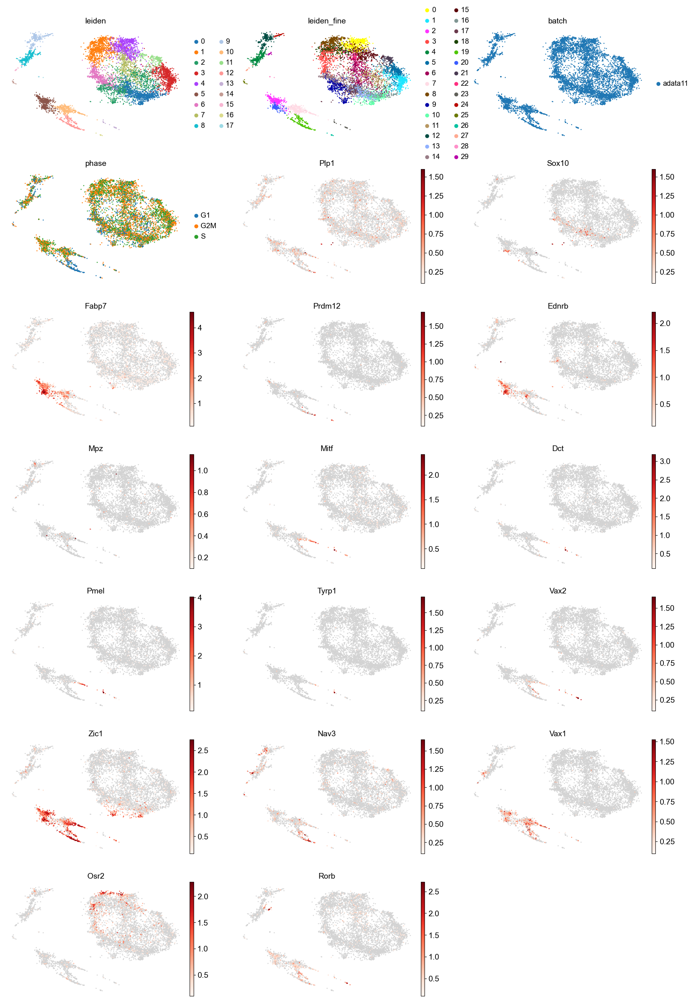

In [46]:
sc.tl.leiden(adata_E11, #name of anndata object
              resolution = 2, key_added = 'leiden_fine')
sc.pl.embedding(
    adata_E11,
    basis='X_scvi_MDE',
    color=['leiden','leiden_fine','batch','phase','Plp1','Sox10','Fabp7','Prdm12','Ednrb','Mpz','Mitf','Dct','Pmel','Tyrp1','Vax2','Zic1','Nav3','Vax1','Osr2','Rorb'],
    #groups=['0','1','2','3','4','6','7','11',],
    frameon=False,
    ncols=3,
    cmap = reds,
    vmin=0.1,
)

1707327723.636714: Regressing cell cycle
1707327812.0318718: Highly Variable Genes
1707327812.7832205: PCA
1707327812.8493247: Neighbors
1707327813.3759422: MDE and UMAP
1707327818.6480877: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


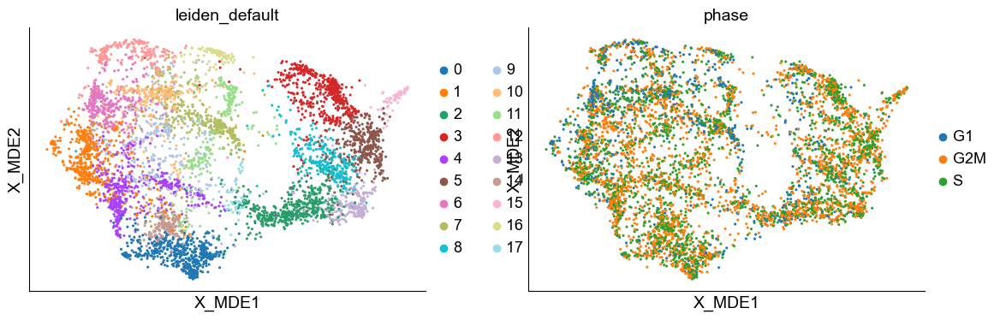

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


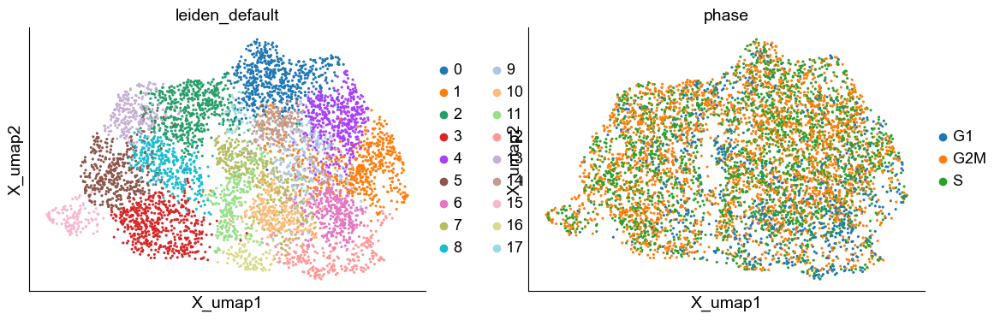

In [158]:
#adata_E11_mesen = adata_E11[adata_E11.obs['leiden'].isin(['0','1','2','3','4','6','7','11'])].copy()
default_regress_cycle_to_mde(adata_E11_mesen, n_neighbors = 10,n_comps=40, skip_preprocess = True, resolution = 1,n_top_genes = 1500)

In [182]:
sc.tl.leiden(adata_E11_mesen, #name of anndata object
             resolution = 1.4, key_added = 'leiden_fine')

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


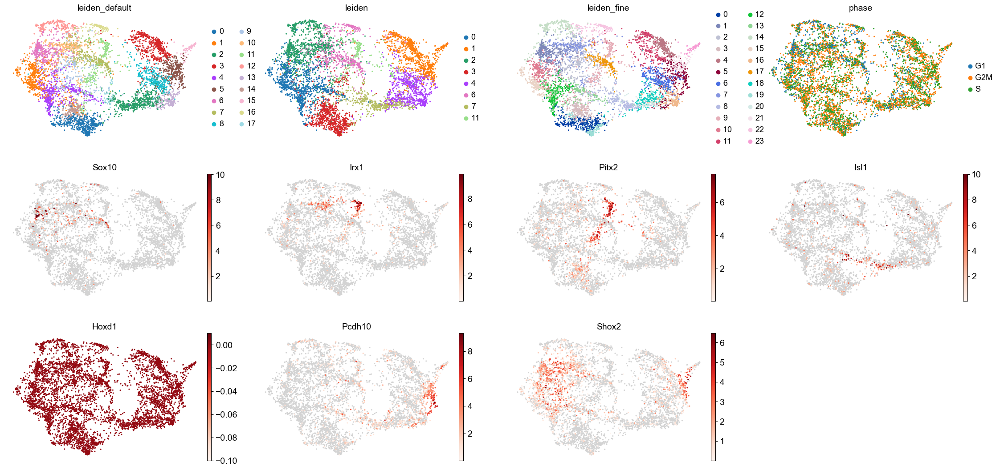

In [372]:
sc.pl.embedding(
    adata_E11_mesen,
    basis='X_MDE',
    color=['leiden_default','leiden','leiden_fine','phase','Sox10','Irx1','Pitx2','Isl1','Hoxd1','Pcdh10','Shox2',],
    #groups=['5','10','21'],
    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.01,
)


#remove Pitx2 Irx1 cluster, eye stuff


#Flrt2 Pax9 large cluster, Posteriovetral medionasal ; Can be split into finer clusters :
                    #Dkk1 Isl2 Lgr5 Pax9, ventral (posterior) medial nasal (cradles vomer) , in coarser: medial nasal, origin FnP
                    #Lgr5, Meis2, Gsc, Sfrp2 Dkk1- Cluster; Lambda? fusion, maybe combine with Dkk1 cluster later

#Dlx5 Lhx8 Gata2 in tip; Anteroventral Medial Nasal; 

#Pax7 cluster, Lateral Nasal Prominence

#pou3f3 Anterior Medial Nasal

#Nr2f2High, GscLow: Posteriodorsal Nasal Cavity ; 
#Tbx22/Irx1/Gsc/Shox2/Flrt2 Tbx22+ Nr2f2Low Medial Nasal -> Posterioventral Nasal Cavity

#Meis2, Mecom, Asb4, Barx1, Meox2, Presumptive palatal shelf
#Dlx5, Pcdh10, Shox2, Osr1/2 In hinge; Ventral Posterior MxP; Posteroventral MxP
#Irx5/3/Foxl2 and Sp5 in tip, cluster close to eye, dorsal part of the mxp; Dorsal MxP



#to show
#Lgi1 Nr4a2 Mecom Aldh1a2 Shisa3 Magel2
#Pitx1 and Hand2, mandible? >but Pcdh10/Shox2 expression is good for the joint. Just exclude Pitx1+ cells
#middle connecting part: Dlx5, Dlx6, Igfbp7, Lhx8, Gata3


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


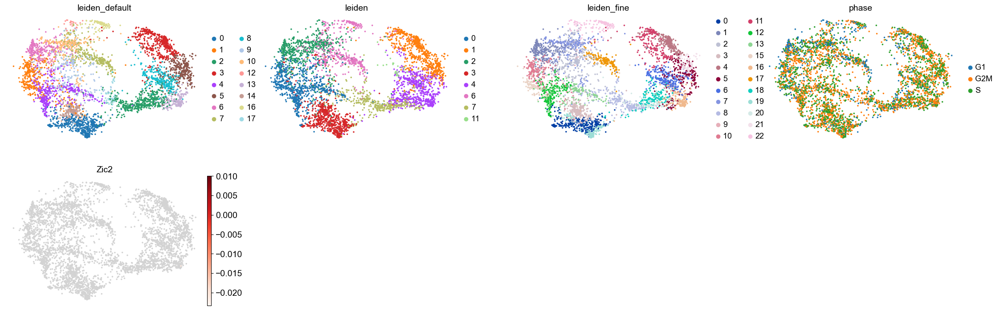

In [251]:
adata_E11_mesen_filt = adata_E11_mesen[(adata_E11_mesen[:,'Zic2'].layers['original_counts']<1), : ].copy() #remove cells expressing hoxb2
adata_E11_mesen_filt = adata_E11_mesen_filt[(adata_E11_mesen_filt[:,'Zic1'].layers['original_counts']<1), : ].copy() #remove cells expressing hoxb2
adata_E11_mesen_filt = adata_E11_mesen_filt[(adata_E11_mesen_filt[:,'Pitx1'].layers['original_counts']<1), : ].copy() #remove cells expressing hoxb2
adata_E11_mesen_filt = adata_E11_mesen_filt[(adata_E11_mesen_filt[:,'Hand2'].layers['original_counts']<1), : ].copy() #remove cells expressing hoxb2


adata_E11_mesen_filt = adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine']!='14'].copy()
adata_E11_mesen_filt = adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine']!='23'].copy()

adata_E11_mesen_filt = adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default']!='11'].copy()


sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_MDE',
    color=['leiden_default','leiden','leiden_fine','phase','Zic2','],
    #groups=['5','10','21'],
    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.01,
)

1707480942.8133895: Highly Variable Genes
1707480943.410928: PCA
1707480943.488087: Neighbors
1707480943.8216772: MDE and UMAP
1707480947.8595889: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


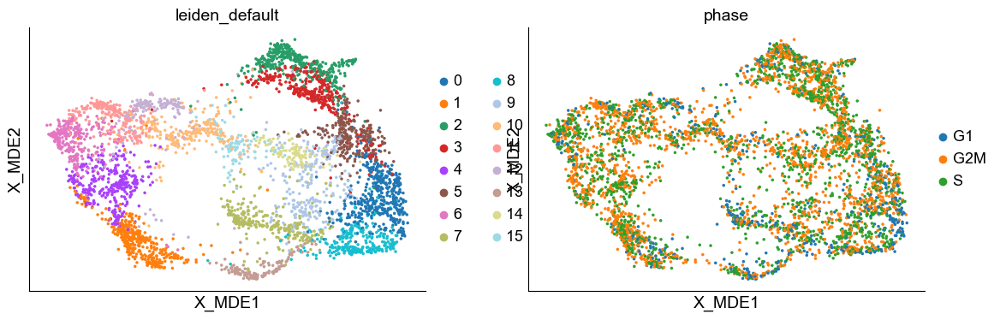

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


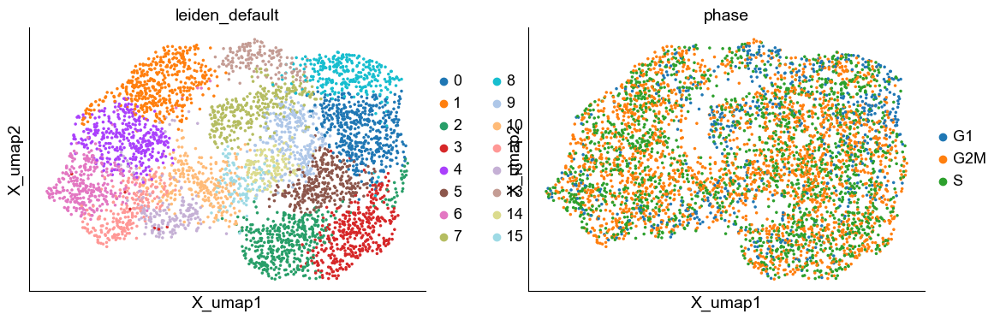

In [254]:
default_regress_cycle_to_mde(adata_E11_mesen_filt, n_neighbors = 10,n_comps=40, skip_preprocess = True, resolution = 1,n_top_genes = 1500)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/sca

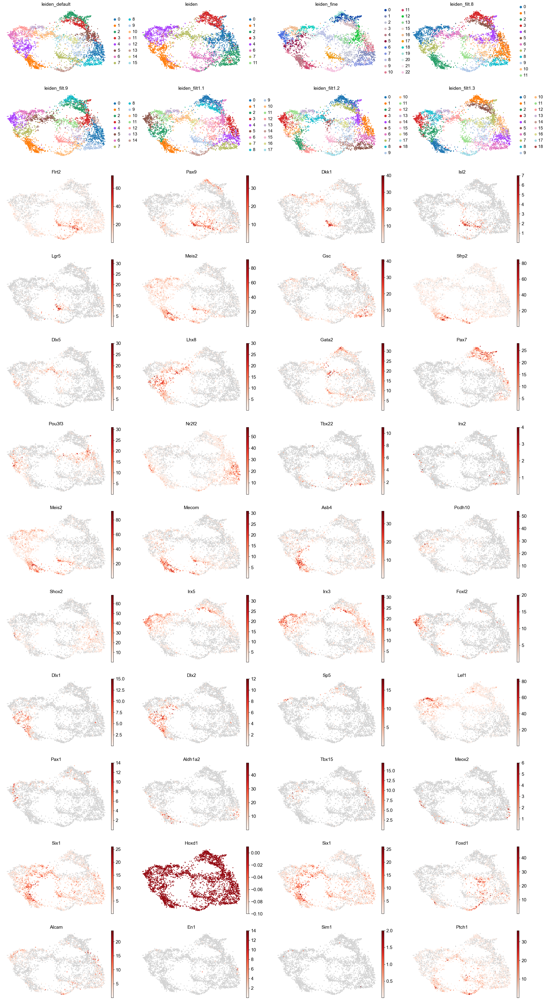

In [36]:
#sc.tl.leiden(adata_E11_mesen_filt, resolution = 1.3, key_added = 'leiden_filt1.3')
sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_MDE',
    color=['leiden_default','leiden','leiden_fine','leiden_filt.8','leiden_filt.9','leiden_filt1.1','leiden_filt1.2','leiden_filt1.3','Flrt2','Pax9','Dkk1','Isl2','Lgr5','Meis2','Gsc','Sfrp2',
           'Dlx5','Lhx8','Gata2','Pax7','Pou3f3','Nr2f2','Tbx22','Irx2','Meis2','Mecom','Asb4','Pcdh10','Shox2','Irx5','Irx3','Foxl2','Dlx1','Dlx2','Sp5','Lef1','Pax1','Aldh1a2','Tbx15','Meox2','Six1',
           'Hoxd1','Six1','Foxd1','Alcam','En1','Sim1','Ptch1',],
    #groups=['5','10','21'],
    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.01,
)

#remove Pitx2 Irx1 cluster, eye stuff


#Flrt2 Pax9 large cluster, Posteriovetral medionasal ; Can be split into finer clusters :
                    #Dkk1 Isl2 Lgr5 Pax9, ventral (posterior) medial nasal (cradles vomer) , in coarser: medial nasal, origin FnP
                    #Lgr5, Meis2, Gsc, Sfrp2 Dkk1- Cluster; Lambda? fusion, maybe combine with Dkk1 cluster later

#Dlx5 Lhx8 Gata2 in tip; Anteroventral Medial Nasal; 

#Pax7 cluster, Lateral Nasal Prominence

#pou3f3 Anterior Medial Nasal

#Nr2f2High, GscLow: Posteriodorsal Nasal Cavity ; 
#Tbx22/Irx1/Gsc/Shox2/Flrt2 Tbx22+ Nr2f2Low Medial Nasal -> Posterioventral Nasal Cavity

#Meis2, Mecom, Asb4, Barx1, Meox2, Presumptive palatal shelf
#Dlx5, Pcdh10, Shox2, Osr1/2 In hinge; Ventral Posterior MxP; Posteroventral MxP
#Irx5/3/Foxl2 and Sp5 in tip, cluster close to eye, dorsal part of the mxp; Dorsal MxP



#to show
#Lgi1 Nr4a2 Mecom Aldh1a2 Shisa3 Magel2
#Pitx1 and Hand2, mandible? >but Pcdh10/Shox2 expression is good for the joint. Just exclude Pitx1+ cells
#middle connecting part: Dlx5, Dlx6, Igfbp7, Lhx8, Gata3


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


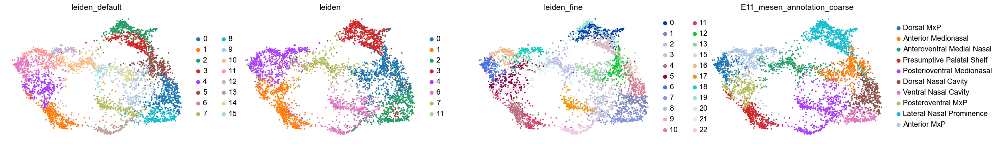

In [60]:
#renaming clusters

######
##TODO
#Lef1 "anterior" cluster, rename to Mesenchyme under ectoderm, lef1 covers both the Irx3/5 part and the Lhx8 part
    #Irx3/5 in side?
    #Lhx8 in tip

adata_E11_mesen_filt.obs['E11_mesen_annotation_coarse'] = adata_E11_mesen_filt.obs['leiden_default'] #create new column
adata_E11_mesen_filt.obs['E11_mesen_annotation_coarse'] = adata_E11_mesen_filt.obs['E11_mesen_annotation_coarse'].cat.add_categories(['Dorsal MxP',
                                                                                                                                      'Anterior Medionasal',
                                                                                                                                      'Anteroventral Medial Nasal',
                                                                                                                                      'Presumptive Palatal Shelf',
                                                                                                                                      'Posterioventral Medionasal',
                                                                                                                                      'Dorsal Nasal Cavity',
                                                                                                                                      'Ventral Nasal Cavity',
                                                                                                                                      'Posteroventral MxP',
                                                                                                                                      'Lateral Nasal Prominence',
                                                                                                                                      'Anterior MxP',
                                                                                                                                     ])#add category names


adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden'] == '0'].obs.index,'E11_mesen_annotation_coarse'] = 'Anterior Medionasal' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '5'].obs.index,'E11_mesen_annotation_coarse'] = 'Anterior Medionasal' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '14'].obs.index,'E11_mesen_annotation_coarse'] = 'Anterior Medionasal' 

adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden'] == '2'].obs.index,'E11_mesen_annotation_coarse'] = 'Dorsal MxP' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden'] == '1'].obs.index,'E11_mesen_annotation_coarse'] = 'Anteroventral Medial Nasal' 

adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '4'].obs.index,'E11_mesen_annotation_coarse'] = 'Posteroventral MxP' #Pcdh10, Shox2, Osr1/2 Hinge
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '1'].obs.index,'E11_mesen_annotation_coarse'] = 'Presumptive Palatal Shelf' #Asb4, Barx1, 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '6'].obs.index,'E11_mesen_annotation_coarse'] = 'Dorsal MxP' #suspected location, Foxl2
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '11'].obs.index,'E11_mesen_annotation_coarse'] = 'Dorsal MxP' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '12'].obs.index,'E11_mesen_annotation_coarse'] = 'Dorsal MxP' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden'] == '7'].obs.index,'E11_mesen_annotation_coarse'] = 'Anteroventral Medial Nasal' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden'] == '6'].obs.index,'E11_mesen_annotation_coarse'] = 'Posterioventral Medionasal' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden'] == '2'].obs.index,'E11_mesen_annotation_coarse'] = 'Dorsal Nasal Cavity' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '0'].obs.index,'E11_mesen_annotation_coarse'] = 'Dorsal Nasal Cavity' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '8'].obs.index,'E11_mesen_annotation_coarse'] = 'Ventral Nasal Cavity' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '2'].obs.index,'E11_mesen_annotation_coarse'] = 'Posterioventral Medionasal' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '17'].obs.index,'E11_mesen_annotation_coarse'] = 'Posterioventral Medionasal' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '22'].obs.index,'E11_mesen_annotation_coarse'] = 'Posterioventral Medionasal' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '2'].obs.index,'E11_mesen_annotation_coarse'] = 'Lateral Nasal Prominence' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '3'].obs.index,'E11_mesen_annotation_coarse'] = 'Lateral Nasal Prominence' 

adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_filt1.1'] == '11'].obs.index,'E11_mesen_annotation_coarse'] = 'Anterior MxP' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_filt1.1'] == '13'].obs.index,'E11_mesen_annotation_coarse'] = 'Anterior MxP' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_annotation_coarse'] == '10'].obs.index,'E11_mesen_annotation_coarse'] = 'Anterior MxP' 

#adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == ''].obs.index,'E11_mesen_annotation_coarse'] = '' 







adata_E11_mesen_filt.obs['E11_mesen_annotation_coarse'] = adata_E11_mesen_filt.obs['E11_mesen_annotation_coarse'].cat.remove_unused_categories() #remove unused categories

sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_MDE',
    color=['leiden_default','leiden','leiden_fine','E11_mesen_annotation_coarse',],
    #groups=['5','10','21'],
    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.01,
)


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


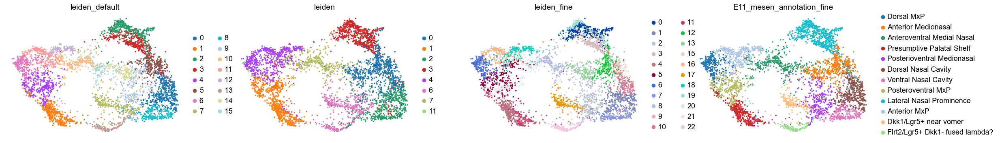

In [57]:
#renaming clusters
adata_E11_mesen_filt.obs['E11_mesen_annotation_fine'] = adata_E11_mesen_filt.obs['leiden_default'] #create new column
adata_E11_mesen_filt.obs['E11_mesen_annotation_fine'] = adata_E11_mesen_filt.obs['E11_mesen_annotation_fine'].cat.add_categories(['Dorsal MxP',
                                                                                                                                      'Anterior Medionasal',
                                                                                                                                      'Anteroventral Medial Nasal',
                                                                                                                                      'Presumptive Palatal Shelf',
                                                                                                                                      'Posterioventral Medionasal',
                                                                                                                                      'Dorsal Nasal Cavity',
                                                                                                                                      'Ventral Nasal Cavity',
                                                                                                                                      'Posteroventral MxP',
                                                                                                                                      'Lateral Nasal Prominence',
                                                                                                                                      'Anterior MxP',
                                                                                                                                  'Dkk1/Lgr5+ near vomer',
                                                                                                                                  'Flrt2/Lgr5+ Dkk1- fused lambda?',
                                                                                                                                     ])#add category names


adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden'] == '0'].obs.index,'E11_mesen_annotation_fine'] = 'Anterior Medionasal' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '5'].obs.index,'E11_mesen_annotation_fine'] = 'Anterior Medionasal' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '14'].obs.index,'E11_mesen_annotation_fine'] = 'Anterior Medionasal' 

adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden'] == '2'].obs.index,'E11_mesen_annotation_fine'] = 'Dorsal MxP' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden'] == '1'].obs.index,'E11_mesen_annotation_fine'] = 'Anteroventral Medial Nasal' 

adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '4'].obs.index,'E11_mesen_annotation_fine'] = 'Posteroventral MxP' #Pcdh10, Shox2, Osr1/2 Hinge
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '1'].obs.index,'E11_mesen_annotation_fine'] = 'Presumptive Palatal Shelf' #Asb4, Barx1, 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '6'].obs.index,'E11_mesen_annotation_fine'] = 'Dorsal MxP' #suspected location, Foxl2
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '11'].obs.index,'E11_mesen_annotation_fine'] = 'Dorsal MxP' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '12'].obs.index,'E11_mesen_annotation_fine'] = 'Dorsal MxP' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden'] == '7'].obs.index,'E11_mesen_annotation_fine'] = 'Anteroventral Medial Nasal' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden'] == '6'].obs.index,'E11_mesen_annotation_fine'] = 'Posterioventral Medionasal' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden'] == '2'].obs.index,'E11_mesen_annotation_fine'] = 'Dorsal Nasal Cavity' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '0'].obs.index,'E11_mesen_annotation_fine'] = 'Dorsal Nasal Cavity' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '8'].obs.index,'E11_mesen_annotation_fine'] = 'Ventral Nasal Cavity' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '2'].obs.index,'E11_mesen_annotation_fine'] = 'Posterioventral Medionasal' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '17'].obs.index,'E11_mesen_annotation_fine'] = 'Posterioventral Medionasal' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '22'].obs.index,'E11_mesen_annotation_fine'] = 'Posterioventral Medionasal' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '2'].obs.index,'E11_mesen_annotation_fine'] = 'Lateral Nasal Prominence' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == '3'].obs.index,'E11_mesen_annotation_fine'] = 'Lateral Nasal Prominence' 

adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_filt1.1'] == '11'].obs.index,'E11_mesen_annotation_fine'] = 'Anterior MxP' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_filt1.1'] == '13'].obs.index,'E11_mesen_annotation_fine'] = 'Anterior MxP' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_annotation_fine'] == '10'].obs.index,'E11_mesen_annotation_fine'] = 'Anterior MxP' 

adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '17'].obs.index,'E11_mesen_annotation_fine'] = 'Dkk1/Lgr5+ near vomer' 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '22'].obs.index,'E11_mesen_annotation_fine'] = 'Flrt2/Lgr5+ Dkk1- fused lambda?' 



#adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_default'] == ''].obs.index,'E11_mesen_annotation_coarse'] = '' 







adata_E11_mesen_filt.obs['E11_mesen_annotation_fine'] = adata_E11_mesen_filt.obs['E11_mesen_annotation_fine'].cat.remove_unused_categories() #remove unused categories

sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_MDE',
    color=['leiden_default','leiden','leiden_fine','E11_mesen_annotation_fine',],
    #groups=['5','10','21'],
    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.01,
)


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


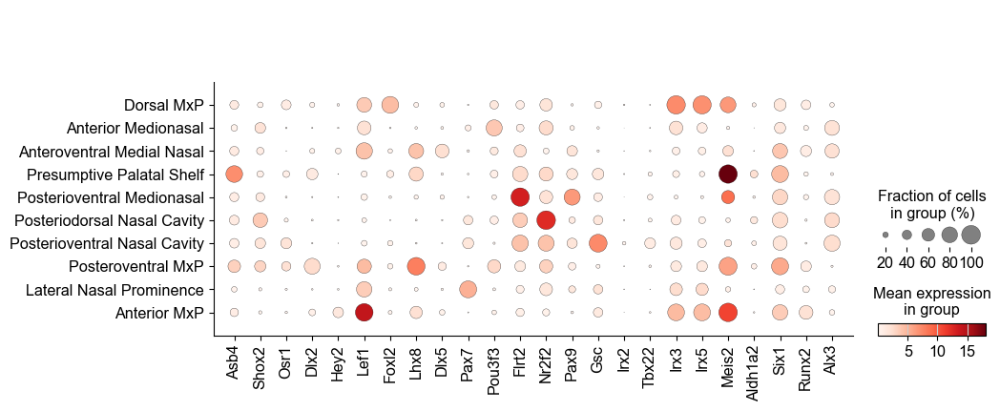

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


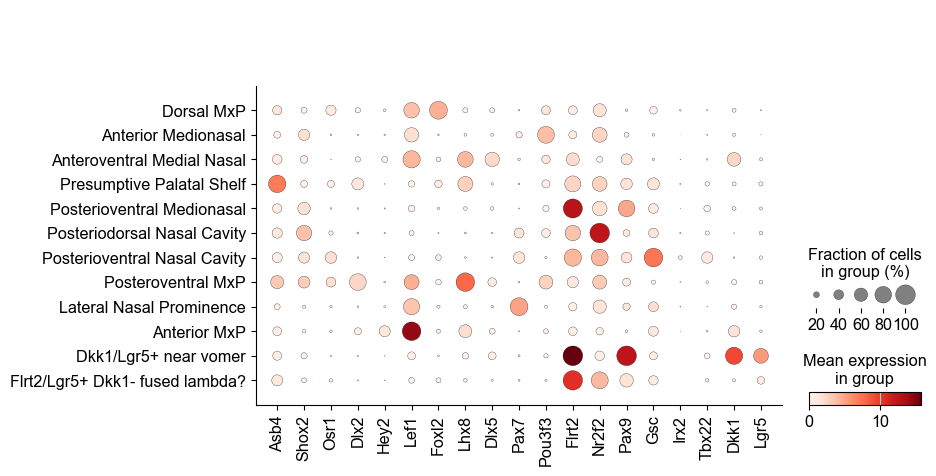

In [56]:
sc.pl.dotplot(adata_E11_mesen_filt, var_names = ['Asb4','Shox2','Osr1','Dlx2','Hey2','Lef1','Foxl2','Lhx8','Dlx5','Pax7','Pou3f3','Flrt2','Nr2f2',
                                                 'Pax9','Gsc','Irx2','Tbx22','Irx3','Irx5','Meis2','Aldh1a2','Six1','Runx2','Alx3',], groupby = 'E11_mesen_annotation_coarse')
sc.pl.dotplot(adata_E11_mesen_filt, var_names = ['Asb4','Shox2','Osr1','Dlx2','Hey2','Lef1','Foxl2','Lhx8','Dlx5','Pax7','Pou3f3','Flrt2','Nr2f2',
                                                 'Pax9','Gsc','Irx2','Tbx22','Dkk1','Lgr5',], groupby = 'E11_mesen_annotation_fine')

In [61]:
#adata_E11_mesen_filt.write('anndata_objects/adata_E11_mesen_annotated.h5ad')

In [3]:
adata_E11_mesen_filt = sc.read('anndata_objects/adata_E11_mesen_annotated.h5ad')

In [12]:
adata_E11_mesen_filt

AnnData object with n_obs × n_vars = 4621 × 22912
    obs: 'Clusters', '_X', '_Y', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'sample', 'barcode', 'batch', 'doublet_score', 'predicted_doublets', 'predicted_doublets_based_on_10x_chromium_spec', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'pct_counts_unspliced', 'pred_doubl_cat', 'stage', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', 'leiden', 'leiden_default', 'leiden_fine', 'E11_mesen_annotation_coarse', 'leiden_filt.8', 'leiden_filt.9', 'leiden_filt1.1', 'leiden_filt1.2', 'leiden_filt1.3', 'E11_mesen_annotation_fine', 'integration_label'
    var: 'gene_name', 'ensembl_id', 'mt', 'rb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'mean', 'std', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'E11_mesen_annotation_coarse_colors', 'E11_mesen_annotat

In [15]:
sc.tl.leiden(adata_E11_mesen_filt, #name of anndata object
              resolution = 1.7, key_added = 'leiden_fine')

In [16]:
#sc.pp.scale(adata_E11_mesen_filt, max_value=10)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


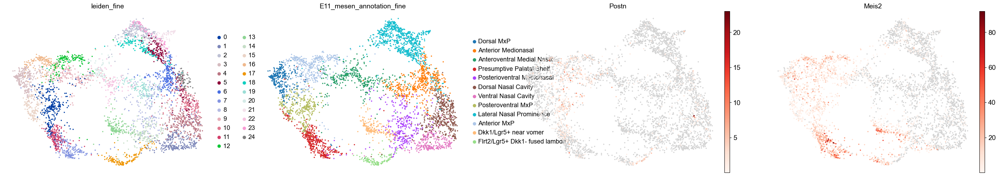

In [17]:
sc.set_figure_params(dpi=50,figsize=[8,6])

sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_MDE',
    color=['leiden_fine','E11_mesen_annotation_fine','Postn','Meis2'],
    #groups=['8','19',],
    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.01,
    #vmax = 10,
)


In [61]:
adata_E11_mesen_filt.X = adata_E11_mesen_filt.layers['original_counts'].copy()
sc.pp.normalize_total(adata_E11_mesen_filt, target_sum=1e4)
sc.pp.log1p(adata_E11_mesen_filt)

In [129]:
sc.tl.rank_genes_groups(adata_E11_mesen_filt,groupby = 'leiden_fine',
                        method = 't-test_overestim_var',
                        #method = 'wilcoxon',
                       )


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


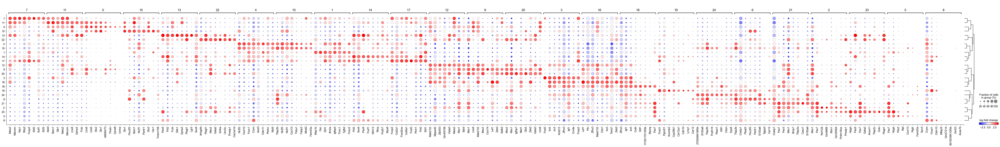

In [130]:
sc.tl.rank_genes_groups(adata_E11_mesen_filt,groupby = 'leiden_fine',
                        method = 't-test_overestim_var',
                        #method = 'wilcoxon',
                       )
sc.tl.dendrogram(adata_E11_mesen_filt, groupby = 'leiden_fine',)
sc.pl.rank_genes_groups_dotplot(adata_E11_mesen_filt,
                                n_genes=8,
                                values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,
    min_logfoldchange=2,
                                #dendrogram = False,
                                #mean_only_expressed=True,
                               #dot_max = 0.5, 
                                #save = 'automatic.pdf'
                               )

categories: 0, 1, 2, etc.
var_group_labels: 2, 23, 5, etc.


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


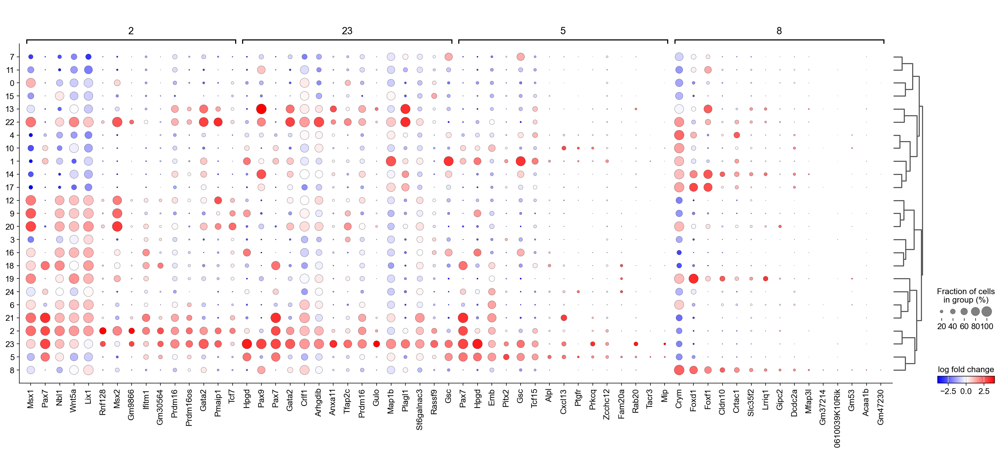

In [358]:
sc.set_figure_params(dpi=70,figsize=[12,10])

sc.pl.rank_genes_groups_dotplot(adata_E11_mesen_filt,
                                n_genes=15,
                                groups = ['2','23','5','8',],
                                values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,
    min_logfoldchange=1.5,
                                #dendrogram = False,
                                #mean_only_expressed=True,
                               #dot_max = 0.5, 
                                #save = 'automatic.pdf'
                               )

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


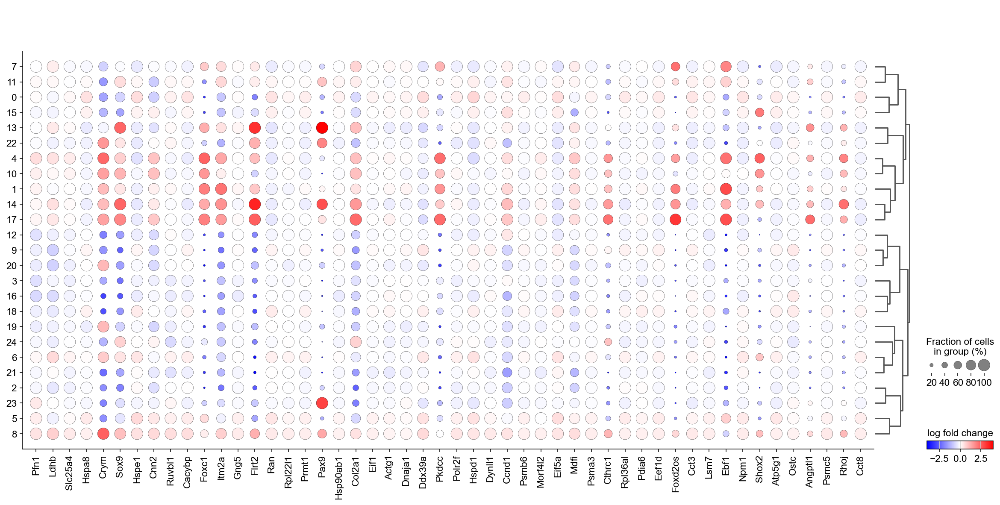

In [363]:
cluster_of_interest = '8'
reference_cluster = '19'
cat_name = 'leiden_fine'
sc.set_figure_params(dpi=70,figsize=[12,10])

sc.tl.rank_genes_groups(adata_E11_mesen_filt, cat_name, groups=[cluster_of_interest], reference=reference_cluster, method='wilcoxon',key_added = 'test')
number_of_genes = 50
genes = adata_E11_mesen_filt.uns['test']['names'][cluster_of_interest][:number_of_genes].tolist()
sc.pl.rank_genes_groups_dotplot(adata_E11_mesen_filt,var_names = genes,groupby='leiden_fine',dendrogram=True,
             values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


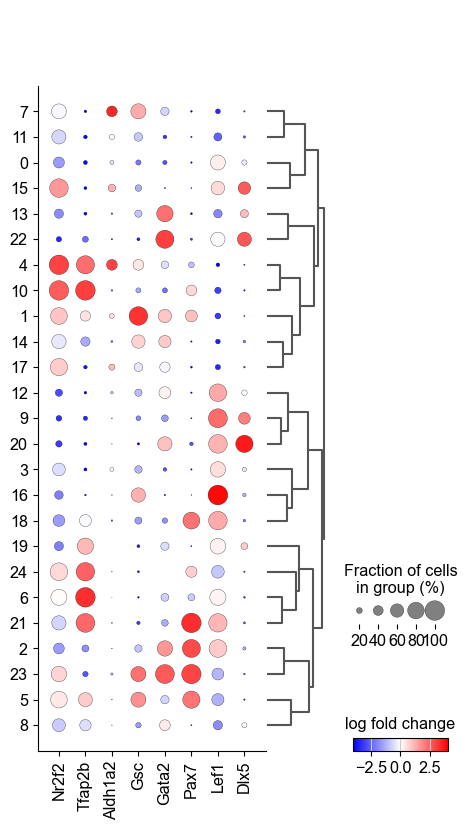

In [283]:
genes = ['Nr2f2','Tfap2b','Aldh1a2','Gsc','Gata2','Pax7','Lef1','Dlx5',]
sc.pl.rank_genes_groups_dotplot(adata_E11_mesen_filt,var_names = genes,groupby='leiden_fine',dendrogram=True,
             values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,)

In [69]:
genes = ['Asb4','Barx1','Dlk1','Mecom','Meis2','Nrp1','Tfap2b','Fabp3','Cxcl13','Ptgfr','Nr2f2','Cxcl12','Cldn11','Shox2','Map1b','Gsc','Ebf1','Igfbp5','Foxp2','Foxd2os','Flrt2','Col9a1',
 'Pax9','Sox9','Plagl1','Arhgdib','Msx2','Gata2','Lef1','Mab21l2','Apcdd1','Zeb2','Msx1','Lhx8','Igfbp7','Zfp503','Pmaip1','Rerg','Dlx2','Lhx6','Dlx1','Foxl2','Kctd12','Irx5','Irx3','Myorg','Fam20a',
 'Lypd1','Kcnd3','Pax7','Hpgd','Gm30564','Rnf128','Ablim1','Gm9866','Cldn10','Slc26a7','Pou3f3','Pantr1','Sgpp2','Foxd1','Kcnmb2','Cdh10','Lrriq1']

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


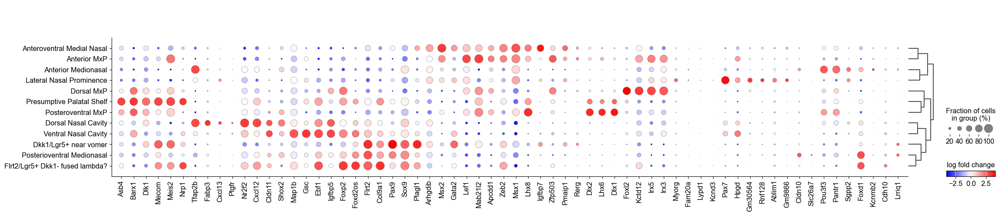

In [74]:
sc.tl.rank_genes_groups(adata_E11_mesen_filt,groupby = 'E11_mesen_annotation_fine',
                        method = 't-test_overestim_var',
                        #method = 'wilcoxon',
                       )
sc.tl.dendrogram(adata_E11_mesen_filt, groupby = 'E11_mesen_annotation_fine',)


sc.pl.rank_genes_groups_dotplot(adata_E11_mesen_filt,var_names = genes,groupby='E11_mesen_annotation_fine',dendrogram=True,
             values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


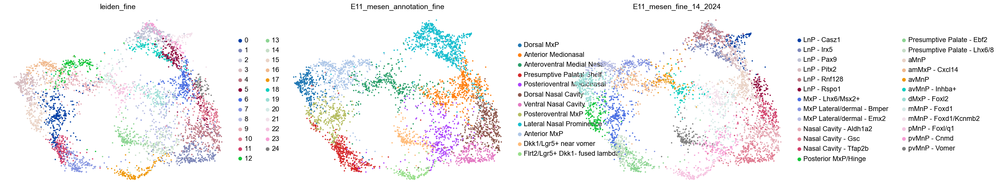

In [18]:
#annotating at 1.7, seems to capture all small populations!
adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] = 'test'

adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '0'].obs.index,'E11_mesen_fine_14_2024'] = 'MxP - Lhx6/Msx2+' #shows some palatal markers but at a lower level. Strong in the Lhx6/8, also has Msx2. Is the only cluster where Lhx6 and Msx2 overlap 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '1'].obs.index,'E11_mesen_fine_14_2024'] = 'Nasal Cavity - Gsc' #Nr2f2, Gsc, Irx1
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '2'].obs.index,'E11_mesen_fine_14_2024'] = 'LnP - Rnf128'#Pax7 Rnf128, Calb2; Pax9-, Gsc- 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '3'].obs.index,'E11_mesen_fine_14_2024'] = 'dMxP - Foxl2' #Dorsal MxP, Foxl2 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '4'].obs.index,'E11_mesen_fine_14_2024'] = 'Nasal Cavity - Aldh1a2' #Nr2f2, Aldh1a2, Tfap2b, Hic1; Pax7-, maybe MnP origin?
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '5'].obs.index,'E11_mesen_fine_14_2024'] = 'LnP - Pitx2' #Pax7, Pitx2, Very similar to 23
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '6'].obs.index,'E11_mesen_fine_14_2024'] = 'aMnP' #Anterior MnP, Pou3f3, Tfap2b, Pantr1/2 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '7'].obs.index,'E11_mesen_fine_14_2024'] = 'Presumptive Palate - Ebf2' #Barx1+ Mecom+ Ebf2+ Lhx6/8-,AI606473-
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '8'].obs.index,'E11_mesen_fine_14_2024'] = 'mMnP - Foxd1' #very similar to 19. Has Pax9 and lacks Kcnmb2
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '9'].obs.index,'E11_mesen_fine_14_2024'] = 'amMxP - Cxcl14' #anterior medial MxP, Cxcl14, Lhx8, Mab21l2, Msx1/2 overlaps a little with Hey2 https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6602358/ 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '10'].obs.index,'E11_mesen_fine_14_2024'] = 'Nasal Cavity - Tfap2b' #Nr2f2, Tfap2b nasal cavity markers but seems to be something intermediary, has high tfap, but lacks aldh1a2 or hic1. Similar somewhat to 24 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '11'].obs.index,'E11_mesen_fine_14_2024'] = 'Presumptive Palate - Lhx6/8' #Ebf2- Lhx6/8high 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '12'].obs.index,'E11_mesen_fine_14_2024'] = 'MxP Lateral/dermal - Bmper' #Bmper, Rerg, Cxxc4, Lef1, Mab21l2 likely dermal mesen next to fusing mxp ecto. https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6602358/ cluster m2
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '13'].obs.index,'E11_mesen_fine_14_2024'] = 'pvMnP - Vomer' #Lgr5, Dkk1 ;Foxd1-
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '14'].obs.index,'E11_mesen_fine_14_2024'] = 'pvMnP - Cnmd' #Cnmd, Moxd1, Erbb3, Lower in vomer markers, higher in chondro markers. Probably condensing septum starting!  
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '15'].obs.index,'E11_mesen_fine_14_2024'] = 'Posterior MxP/Hinge' #Dlx5, Osr1/2 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '16'].obs.index,'E11_mesen_fine_14_2024'] = 'MxP Lateral/dermal - Emx2' #Hey2, Lef1, Emx2, Irx3/5, Also Runx2? https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6602358/
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '17'].obs.index,'E11_mesen_fine_14_2024'] = 'pMnP - Foxl/q1' #Foxl1/q1+ Ebf2, Foxp2, Foxf2, Foxd1, Col18a1, Shares some expression with 7, they're probably where mnp meets mxp around the palate area. has a lot of different fox
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '18'].obs.index,'E11_mesen_fine_14_2024'] = 'LnP - Irx5' #Irx5, Wif1,Pax7
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '19'].obs.index,'E11_mesen_fine_14_2024'] = 'mMnP - Foxd1/Kcnmb2'#Foxd1, Kcnmb2 , Pou3f3 and Pantr1+
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '20'].obs.index,'E11_mesen_fine_14_2024'] = 'avMnP'#Anteroventral mnp Dlx5, Igfbp7, Lhx8, Isl1 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '21'].obs.index,'E11_mesen_fine_14_2024'] = 'LnP - Casz1'#Casz1, Pax7 Aqp1 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '22'].obs.index,'E11_mesen_fine_14_2024'] = 'avMnP - Inhba+' #Anteroventral MnP Inhba+; Lhx8,Dlx5; Foxd1Low
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '23'].obs.index,'E11_mesen_fine_14_2024'] = 'LnP - Pax9'#Pax7, Pax9,Hpgd, Gulo, Gsc, Tfap2a/c; Irx5- 
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_fine'] == '24'].obs.index,'E11_mesen_fine_14_2024'] = 'LnP - Rspo1' #probably Dorsal FnP, is Pax7+ 

adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] = adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'].astype('category')
sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_MDE',
    color=['leiden_fine','E11_mesen_annotation_fine','E11_mesen_fine_14_2024',],
    #groups=['8','19',],
    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.01,
)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


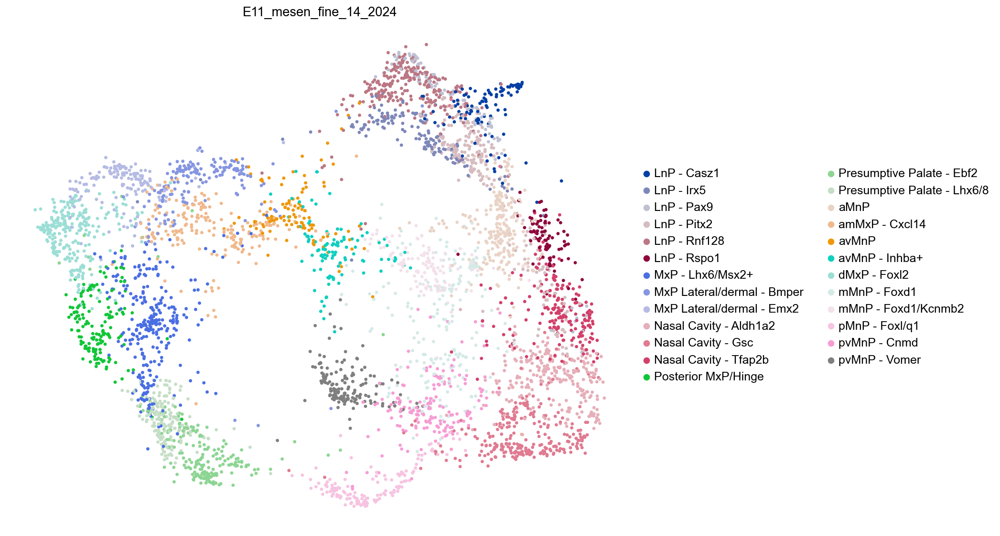

In [19]:
sc.set_figure_params(dpi=70,figsize=[12,10])

sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_MDE',
    color=['E11_mesen_fine_14_2024',],
    #groups=['8','19',],
    frameon=False,
    ncols=4,
    size = 50,
    cmap = reds,
    vmin=0.01,)

In [20]:
adata_E11_mesen_filt.obs['E11_mesen_annotation_main'] = 'test'

adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'LnP - Casz1'].obs.index,'E11_mesen_annotation_main'] = 'LnP - Casz1' #Casz1, Pax7
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'LnP - Irx5'].obs.index,'E11_mesen_annotation_main'] = 'LnP - Irx5' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'LnP - Pax9'].obs.index,'E11_mesen_annotation_main'] = 'LnP - Gata2' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'LnP - Pitx2'].obs.index,'E11_mesen_annotation_main'] = 'LnP - Gata2' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'LnP - Rnf128'].obs.index,'E11_mesen_annotation_main'] = 'LnP - Gata2' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'Nasal Cavity - Aldh1a2'].obs.index,'E11_mesen_annotation_main'] = 'Nasal Cavity' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'Nasal Cavity - Gsc'].obs.index,'E11_mesen_annotation_main'] = 'Nasal Cavity' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'Nasal Cavity - Tfap2b'].obs.index,'E11_mesen_annotation_main'] = 'Nasal Cavity' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'LnP - Rspo1'].obs.index,'E11_mesen_annotation_main'] = 'Nasal Cavity' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'mMnP - Foxd1'].obs.index,'E11_mesen_annotation_main'] = 'mMnP' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'mMnP - Foxd1/Kcnmb2'].obs.index,'E11_mesen_annotation_main'] = 'mMnP' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'pvMnP - Cnmd'].obs.index,'E11_mesen_annotation_main'] = 'pvMnP' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'pvMnP - Vomer'].obs.index,'E11_mesen_annotation_main'] = 'pvMnP' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'pMnP - Foxl/q1'].obs.index,'E11_mesen_annotation_main'] = 'pvMnP' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'avMnP'].obs.index,'E11_mesen_annotation_main'] = 'avMnP' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'avMnP - Inhba+'].obs.index,'E11_mesen_annotation_main'] = 'avMnP' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'dMxP - Foxl2'].obs.index,'E11_mesen_annotation_main'] = 'dMxP' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'MxP Lateral/dermal - Bmper'].obs.index,'E11_mesen_annotation_main'] = 'lMxP' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'MxP Lateral/dermal - Emx2'].obs.index,'E11_mesen_annotation_main'] = 'lMxP' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'amMxP - Cxcl14'].obs.index,'E11_mesen_annotation_main'] = 'lMxP' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'Presumptive Palate - Ebf2'].obs.index,'E11_mesen_annotation_main'] = 'mMxP' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'Presumptive Palate - Lhx6/8'].obs.index,'E11_mesen_annotation_main'] = 'mMxP' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'Posterior MxP/Hinge'].obs.index,'E11_mesen_annotation_main'] = 'pMxP' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'MxP - Lhx6/Msx2+'].obs.index,'E11_mesen_annotation_main'] = 'MxP - Lhx8' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'aMnP'].obs.index,'E11_mesen_annotation_main'] = 'aMnP' #

adata_E11_mesen_filt.obs['E11_mesen_annotation_finest'] = list(adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'])

adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == 'LnP - Rspo1'].obs.index,'E11_mesen_annotation_finest'] = 'Nasal Cavity - Rspo1' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == ''].obs.index,'E11_mesen_annotation_finest'] = '' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == ''].obs.index,'E11_mesen_annotation_finest'] = '' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == ''].obs.index,'E11_mesen_annotation_finest'] = '' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == ''].obs.index,'E11_mesen_annotation_finest'] = '' #
adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_fine_14_2024'] == ''].obs.index,'E11_mesen_annotation_finest'] = '' #


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


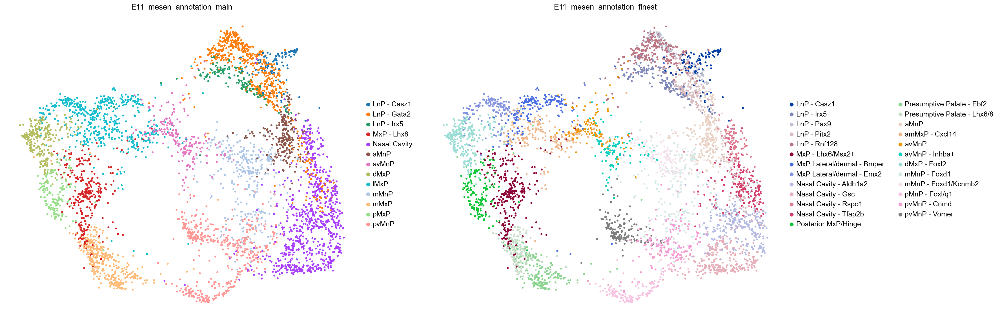

In [21]:
sc.set_figure_params(dpi=70,figsize=[12,10])

sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_MDE',
    color=['E11_mesen_annotation_main','E11_mesen_annotation_finest'],
    #groups=['test',],
    frameon=False,
    ncols=4,
    size = 50,
    cmap = reds,
    vmin=0.01,)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


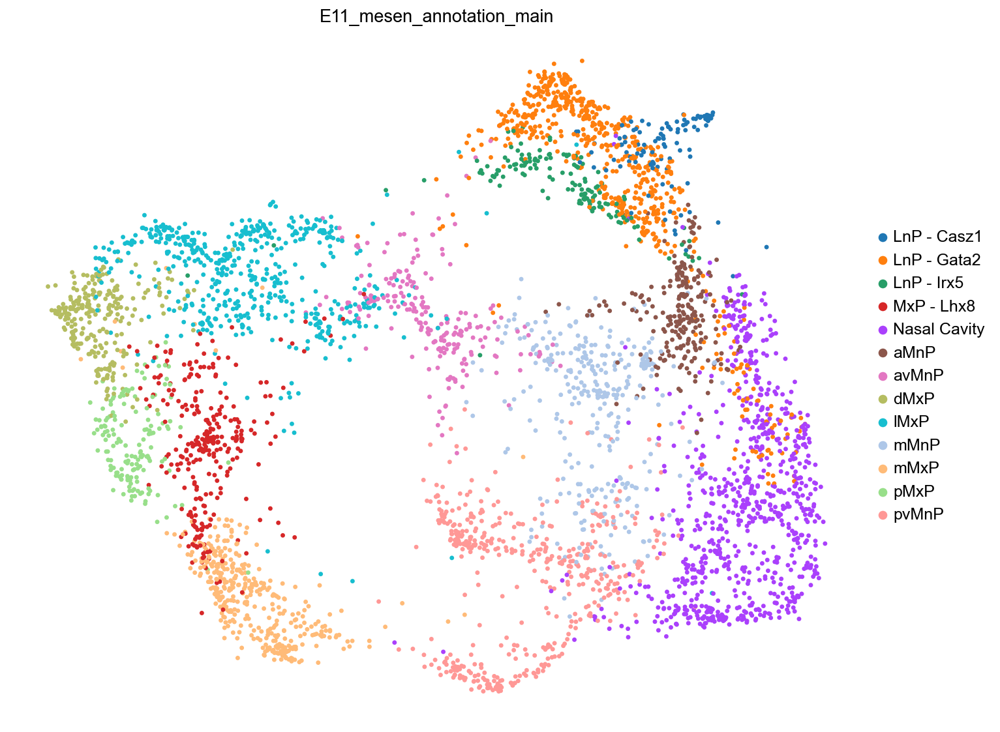

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


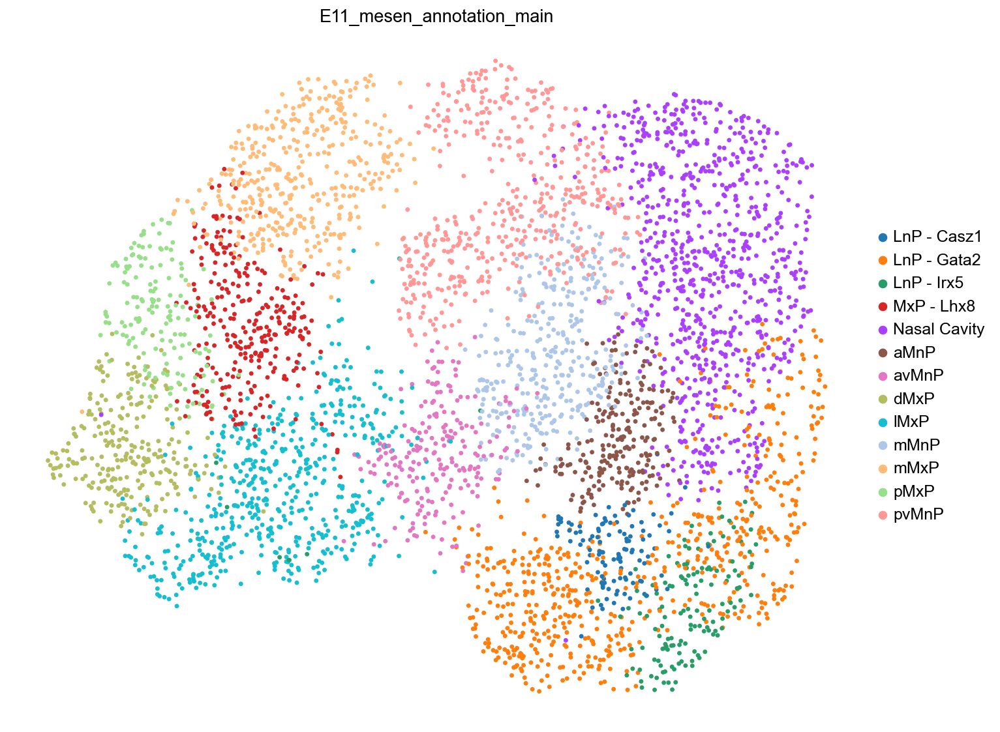

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


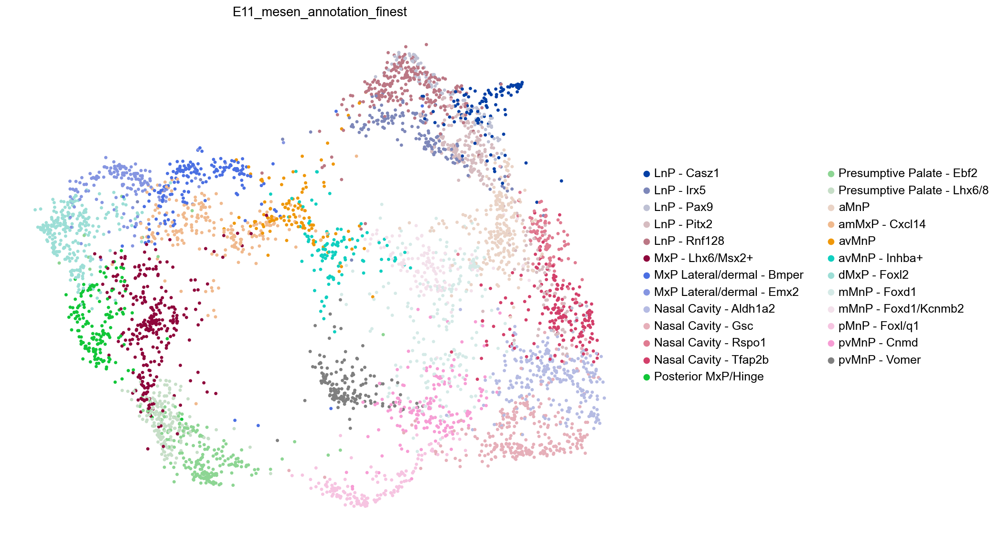

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


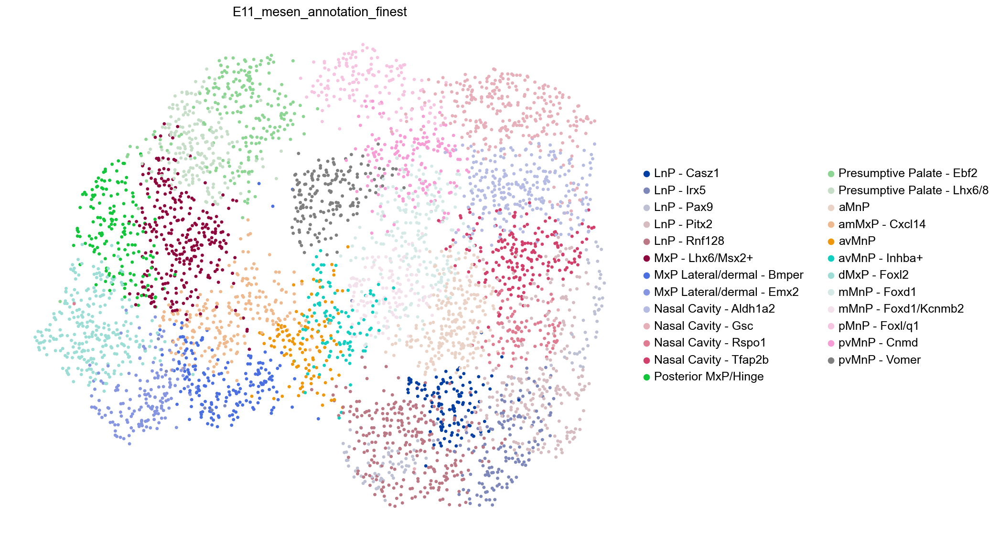

In [472]:
from pathlib import Path
sc._settings.ScanpyConfig.figdir=Path('./figures/new_figures_23_5_2024') #set figdir
sc.set_figure_params(dpi=70,figsize=[12,10])

sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_MDE',
    color=['E11_mesen_annotation_main',],
    #groups=['Whisker Pad','test'],
    frameon=False,
    ncols=4,
    size = 50,
    cmap = reds,
    vmin=0.01,
    save = '_E11_mesen_annotation_main.pdf'
)

sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_umap',
    color=['E11_mesen_annotation_main',],
    #groups=['Whisker Pad','test'],
    frameon=False,
    ncols=4,
    size = 50,
    cmap = reds,
    vmin=0.01,
    save = '_E11_mesen_annotation_main.pdf'
)

sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_MDE',
    color=['E11_mesen_annotation_finest',],
    #groups=['Whisker Pad','test'],
    frameon=False,
    ncols=4,
    size = 50,
    cmap = reds,
    vmin=0.01,
    save = '_E11_mesen_annotation_finest.pdf'
)

sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_umap',
    color=['E11_mesen_annotation_finest',],
    #groups=['Whisker Pad','test'],
    frameon=False,
    ncols=4,
    size = 50,
    cmap = reds,
    vmin=0.01,
    save = '_E11_mesen_annotation_finest.pdf'
)


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


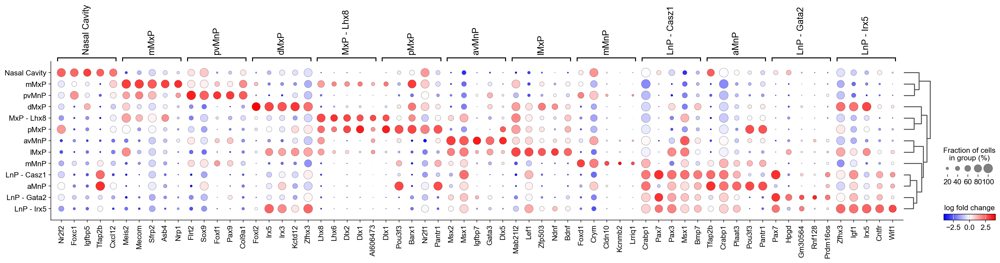

In [473]:
sc.tl.rank_genes_groups(adata_E11_mesen_filt,groupby = 'E11_mesen_annotation_main',
                        method = 't-test_overestim_var',
                        #method = 'wilcoxon',
                       )

sc.tl.dendrogram(adata_E11_mesen_filt, groupby = 'E11_mesen_annotation_main',)
sc.pl.rank_genes_groups_dotplot(adata_E11_mesen_filt,
                                n_genes=5,
                                values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,
    min_logfoldchange=2,
                                #dendrogram = False,
                                #mean_only_expressed=True,
                               #dot_max = 0.5, 
                                save = 'E11_mesen_main_automatic.pdf'
                               )

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


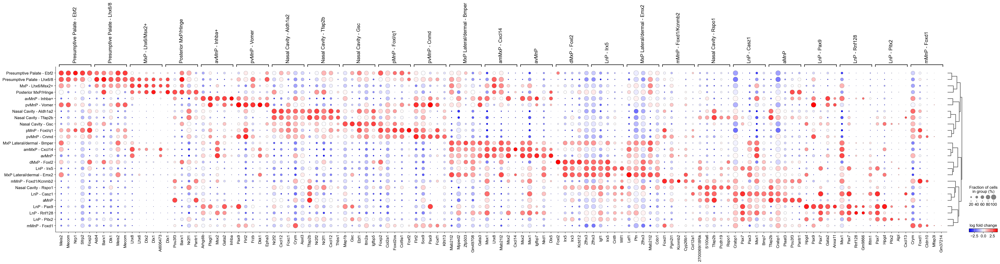

In [474]:
sc.tl.rank_genes_groups(adata_E11_mesen_filt,groupby = 'E11_mesen_annotation_finest',
                        method = 't-test_overestim_var',
                        #method = 'wilcoxon',
                       )

sc.tl.dendrogram(adata_E11_mesen_filt, groupby = 'E11_mesen_annotation_finest',)
sc.pl.rank_genes_groups_dotplot(adata_E11_mesen_filt,
                                n_genes=5,
                                values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,
    min_logfoldchange=2,
                                #dendrogram = False,
                                #mean_only_expressed=True,
                               #dot_max = 0.5, 
                                save = 'E11_mesen_finest_automatic.pdf'
                               )

In [22]:
# #adata_E11_mesen_filt.write('anndata_objects/adata_E11_mesen_annotation_2024.h5ad')
# adata_E11_mesen_filt = sc.read('anndata_objects/adata_E11_mesen_annotation_2024.h5ad')

#adata_E11_mesen_filt.obs['E11_mesen_annotation_main_old'] = adata_E11_mesen_filt.obs['E11_mesen_annotation_main']

# adata_E11_mesen_filt.obs['E11_mesen_annotation_main'] = list(adata_E11_mesen_filt.obs['E11_mesen_annotation_main_old'])
# adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_annotation_fine'] == 'Dorsal Nasal Cavity'].obs.index,'E11_mesen_annotation_main'] = 'Dorsal Nasal Cavity' 
# adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_annotation_fine'] == 'Ventral Nasal Cavity'].obs.index,'E11_mesen_annotation_main'] = 'Ventral Nasal Cavity' 
# adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_annotation_main'] == 'Nasal Cavity'].obs.index,'E11_mesen_annotation_main'] = 'Dorsal Nasal Cavity' 

# adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_annotation_main'] == 'pMxP'].obs.index,'E11_mesen_annotation_main'] = 'MxP - Lhx8' 
# adata_E11_mesen_filt.obs.loc[adata_E11_mesen_filt[adata_E11_mesen_filt.obs['E11_mesen_annotation_fine'] == 'Presumptive Palatal Shelf'].obs.index,'E11_mesen_annotation_main'] = 'mMxP' 


In [25]:
#adata_E11_mesen_filt.write('anndata_objects/adata_E11_mesen_annotation_2024.h5ad')

adata_E11_mesen_filt = sc.read('anndata_objects/adata_E11_mesen_annotation_2024.h5ad')

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


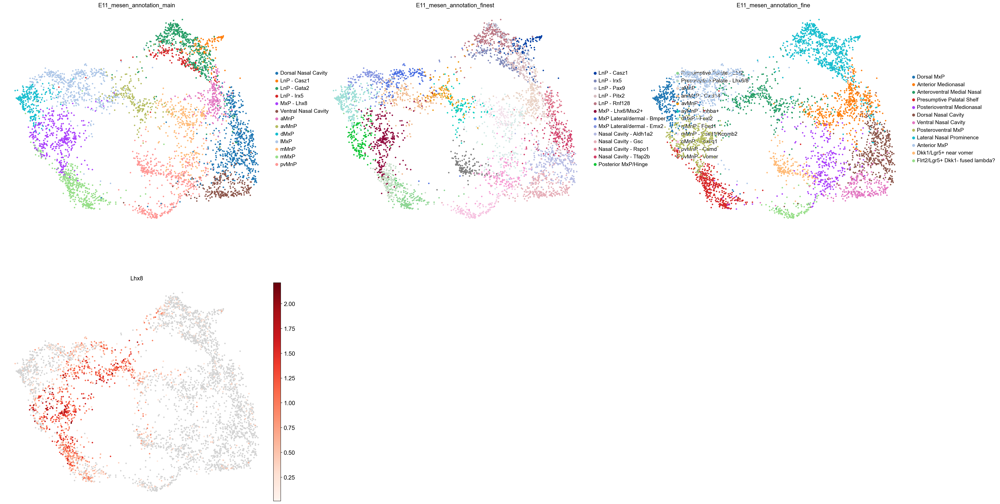

In [23]:
sc.set_figure_params(dpi=70,figsize=[12,10])

sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_MDE',
    color=['E11_mesen_annotation_main','E11_mesen_annotation_finest','E11_mesen_annotation_fine','Lhx8'],
    #groups=['test',],
    frameon=False,
    ncols=3,
    size = 50,
    cmap = reds,
    vmin=0.01,)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


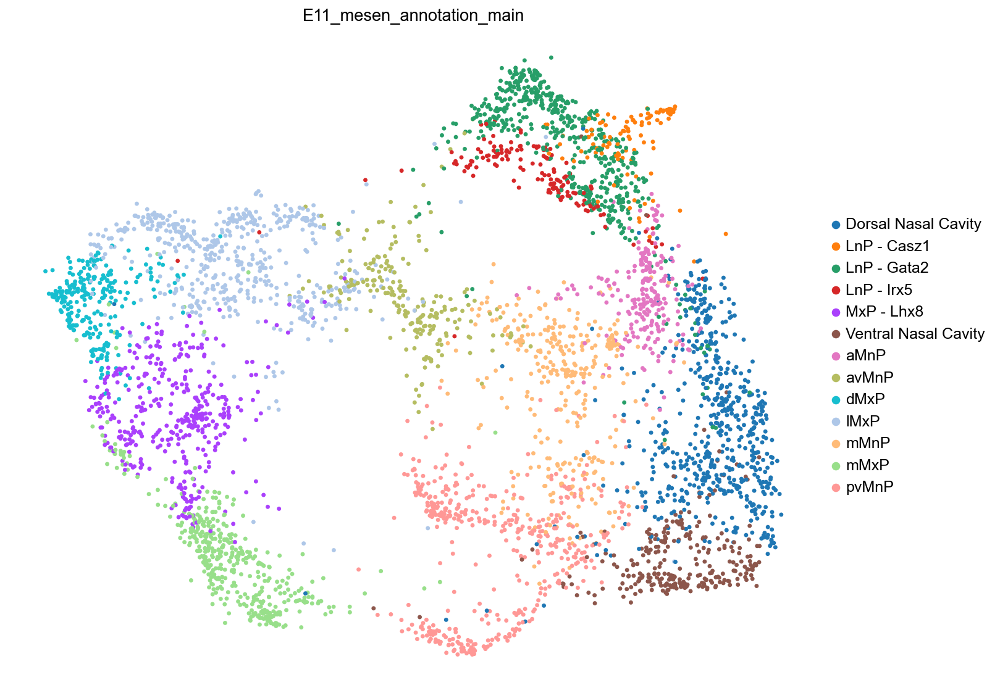

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


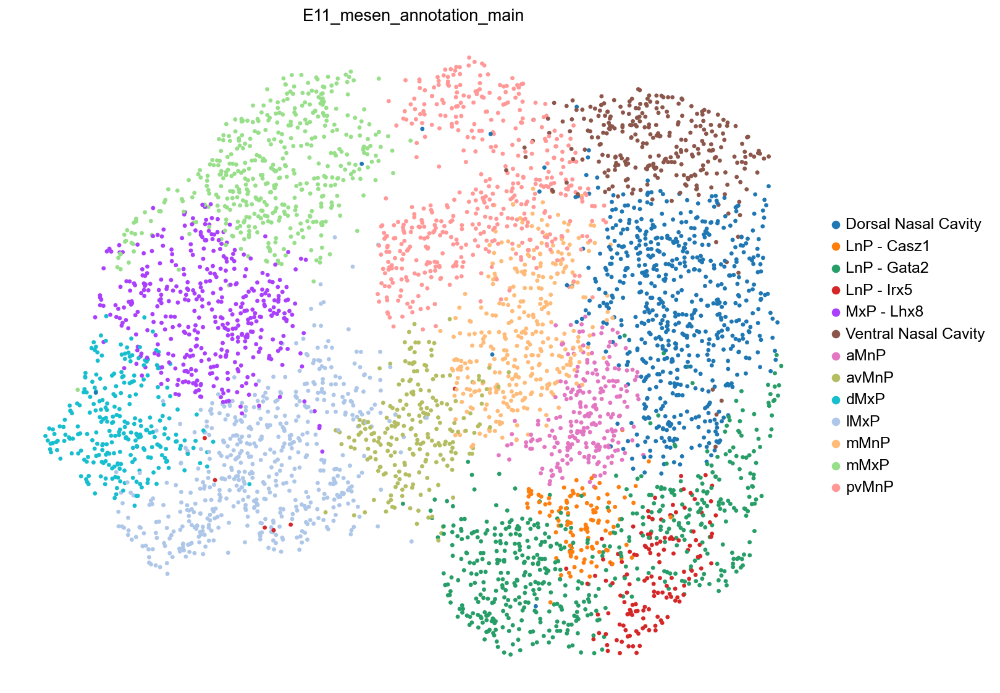

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


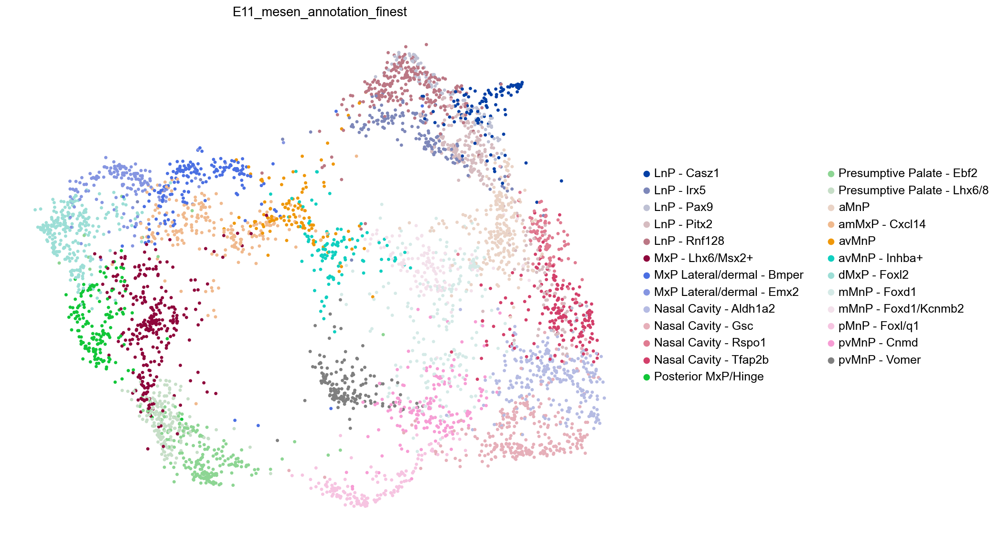

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


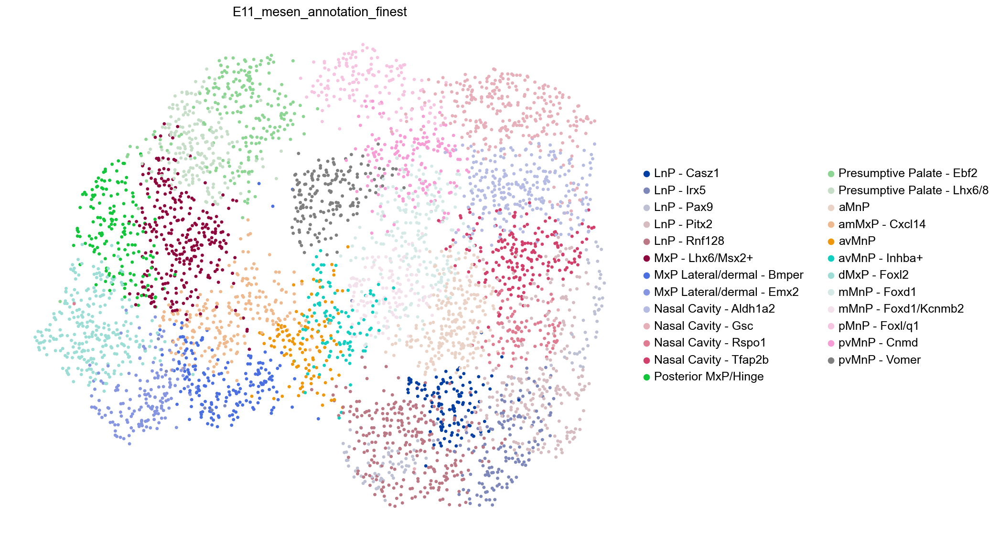

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


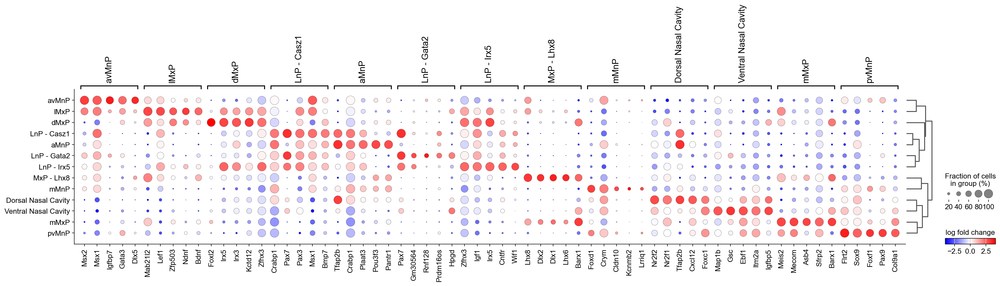

In [24]:
from pathlib import Path
sc._settings.ScanpyConfig.figdir=Path('./figures/new_figures_23_5_2024') #set figdir
sc.set_figure_params(dpi=70,figsize=[12,10])

sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_MDE',
    color=['E11_mesen_annotation_main',],
    #groups=['Whisker Pad','test'],
    frameon=False,
    ncols=4,
    size = 50,
    cmap = reds,
    vmin=0.01,
    save = '_E11_mesen_annotation_main.pdf'
)

sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_umap',
    color=['E11_mesen_annotation_main',],
    #groups=['Whisker Pad','test'],
    frameon=False,
    ncols=4,
    size = 50,
    cmap = reds,
    vmin=0.01,
    save = '_E11_mesen_annotation_main.pdf'
)

sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_MDE',
    color=['E11_mesen_annotation_finest',],
    #groups=['Whisker Pad','test'],
    frameon=False,
    ncols=4,
    size = 50,
    cmap = reds,
    vmin=0.01,
    save = '_E11_mesen_annotation_finest.pdf'
)

sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_umap',
    color=['E11_mesen_annotation_finest',],
    #groups=['Whisker Pad','test'],
    frameon=False,
    ncols=4,
    size = 50,
    cmap = reds,
    vmin=0.01,
    save = '_E11_mesen_annotation_finest.pdf'
)


sc.tl.rank_genes_groups(adata_E11_mesen_filt,groupby = 'E11_mesen_annotation_main',
                        method = 't-test_overestim_var',
                        #method = 'wilcoxon',
                       )

sc.tl.dendrogram(adata_E11_mesen_filt, groupby = 'E11_mesen_annotation_main',)
sc.pl.rank_genes_groups_dotplot(adata_E11_mesen_filt,
                                n_genes=5,
                                values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,
    min_logfoldchange=2,
                                #dendrogram = False,
                                #mean_only_expressed=True,
                               #dot_max = 0.5, 
                                save = 'E11_mesen_main_automatic.pdf'
                               )

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


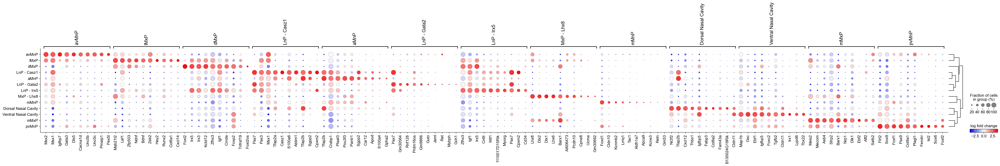

In [32]:
sc.pl.rank_genes_groups_dotplot(adata_E11_mesen_filt,
                                n_genes=10,
                                values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,
    min_logfoldchange=2.2,
                                #dendrogram = False,
                                #mean_only_expressed=True,
                               #dot_max = 0.5, 
                                #save = 'E11_mesen_main_automatic.pdf'
                               )

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


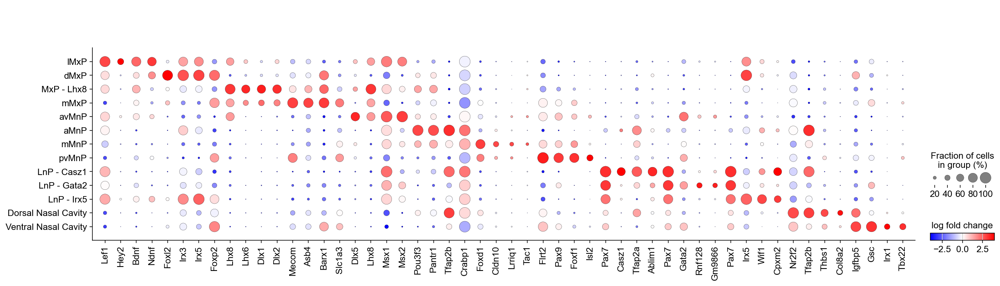

In [33]:
sc.pl.rank_genes_groups_dotplot(adata_E11_mesen_filt,
                                #n_genes=5,
                                var_names = ['Lef1','Hey2','Bdnf','Ndnf',
                                             'Foxl2','Irx3','Irx5','Foxp2',
                                             'Lhx8','Lhx6','Dlx1','Dlx2',
                                             'Mecom','Asb4','Barx1','Slc1a3',
                                             'Dlx5','Lhx8','Msx1','Msx2',
                                             'Pou3f3','Pantr1','Tfap2b','Crabp1',
                                             'Foxd1','Cldn10','Lrriq1','Tac1',
                                             'Flrt2','Pax9','Foxf1','Isl2',
                                             'Pax7','Casz1','Tfap2a','Ablim1',
                                             'Pax7','Gata2','Rnf128','Gm9866',
                                             'Pax7','Irx5','Wif1','Cpxm2',
                                             'Nr2f2','Tfap2b','Thbs1','Col8a2',
                                             'Igfbp5','Gsc','Irx1','Tbx22',
                                            ],
                                values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,
    min_logfoldchange=2,
                                categories_order = ['lMxP','dMxP','MxP - Lhx8','mMxP','avMnP','aMnP','mMnP','pvMnP','LnP - Casz1','LnP - Gata2','LnP - Irx5','Dorsal Nasal Cavity','Ventral Nasal Cavity',],
                                dendrogram = False,
                                #mean_only_expressed=True,
                               #dot_max = 0.5, 
                                #save = 'E11_mesen_main_automatic.pdf'
                               )

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


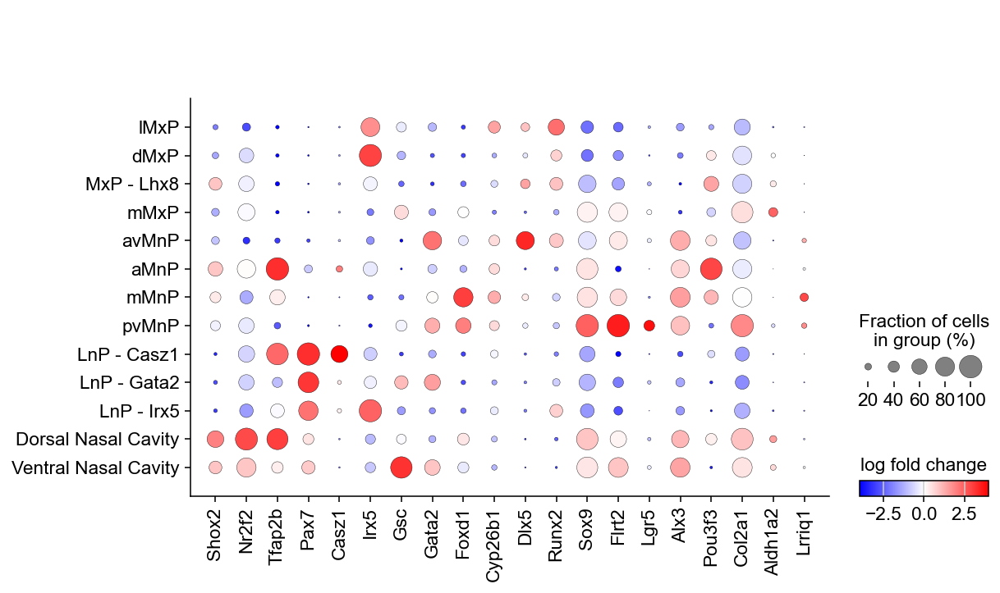

In [35]:
sc.pl.rank_genes_groups_dotplot(adata_E11_mesen_filt,
                                #n_genes=5,
                                var_names = ['Shox2', 'Nr2f2', 'Tfap2b', 'Pax7', 'Casz1', 'Irx5', 'Gsc', 'Gata2', 'Foxd1', 'Cyp26b1', 
                                             'Dlx5', 'Runx2', 'Sox9', 'Flrt2', 'Lgr5', 'Alx3', 'Pou3f3', 'Col2a1', 'Aldh1a2', 'Lrriq1'
                                            ],
                                values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,
    min_logfoldchange=2,
                                categories_order = ['lMxP','dMxP','MxP - Lhx8','mMxP','avMnP','aMnP','mMnP','pvMnP','LnP - Casz1','LnP - Gata2','LnP - Irx5','Dorsal Nasal Cavity','Ventral Nasal Cavity',],
                                dendrogram = False,
                                #mean_only_expressed=True,
                               #dot_max = 0.5, 
                                #save = 'E11_mesen_main_automatic.pdf'
                               )

In [38]:
adata_E11_mesen_filt.uns['E11_mesen_annotation_main_colors'] = [
    "#edc549",#Dorsal Nasal Cavity
    "#cf8d76",#LnP Casz1
    "#d35236",#LnP Gata2
    "#723729",#LnP Irx5
    '#0045aa',#MxP Lhx8
    "#e4672f",#Ventral Nasal Cavity
    "#c8b23c",#aMnP
    "#aeb879",#avMnP
    '#eb5fff',#dMxP
    '#e2008e',#lMxP
    "#596529",#mMxP
    '#9945c4',#mMnp
    "#77c842"]#pvMnP
    
 

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


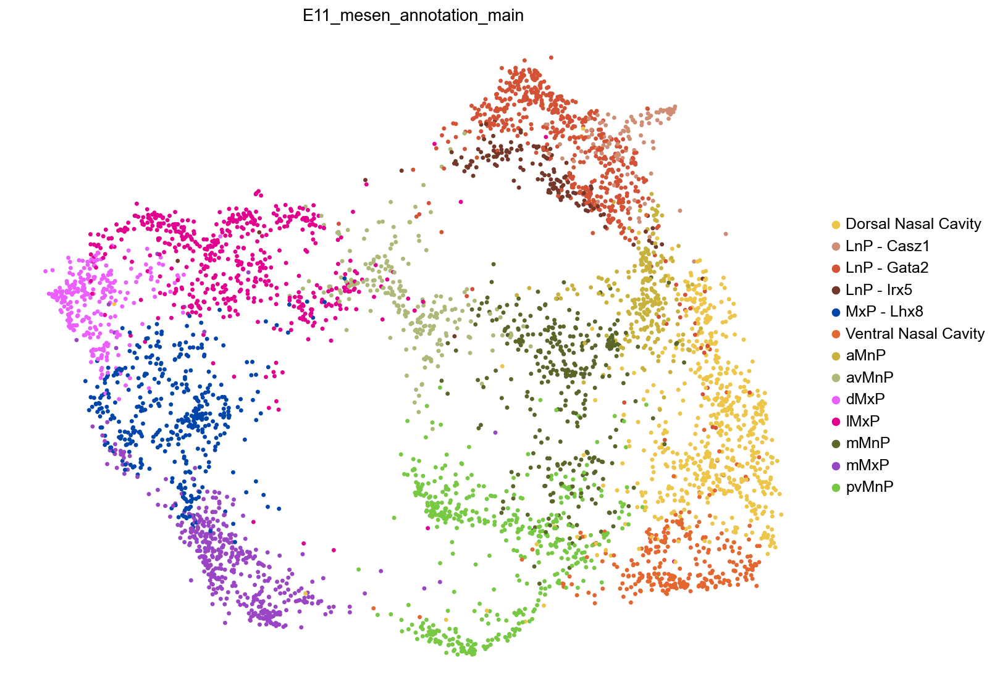

In [39]:
sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_MDE',
    color=['E11_mesen_annotation_main',],
    #groups=['Whisker Pad','test'],
    frameon=False,
    ncols=4,
    size = 50,
    cmap = reds,
    vmin=0.01,
    #save = '_E11_mesen_annotation_main.pdf'
)

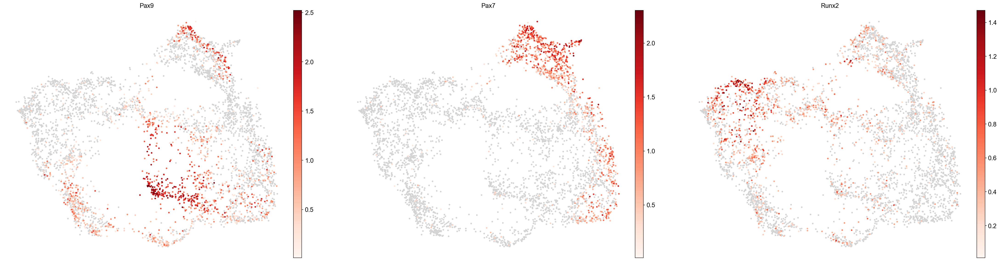

In [41]:
sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_MDE',
    color=['Pax9','Pax7','Runx2',],
    #groups=['Whisker Pad','test'],
    frameon=False,
    ncols=4,
    size = 50,
    cmap = reds,
    vmin=0.01,
    #save = '_E11_mesen_annotation_main.pdf'
)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


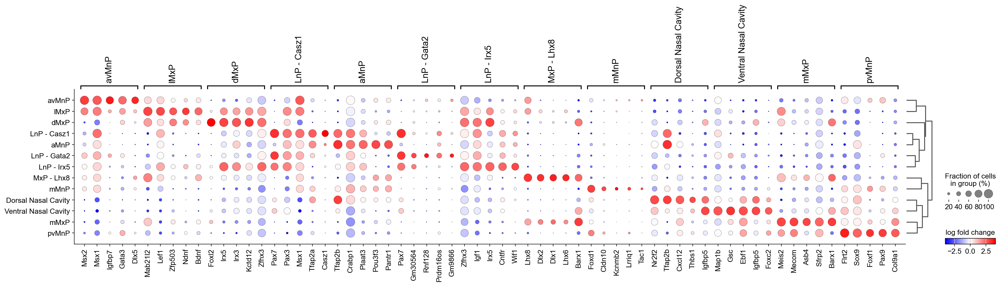

In [26]:
sc.pl.rank_genes_groups_dotplot(adata_E11_mesen_filt,
                                n_genes=5,
                                values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-4,
    vmax=4,
    min_logfoldchange=2.2,
                                #dendrogram = False,
                                #mean_only_expressed=True,
                               #dot_max = 0.5, 
                                save = 'E11_mesen_main_automatic.pdf'
                               )

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


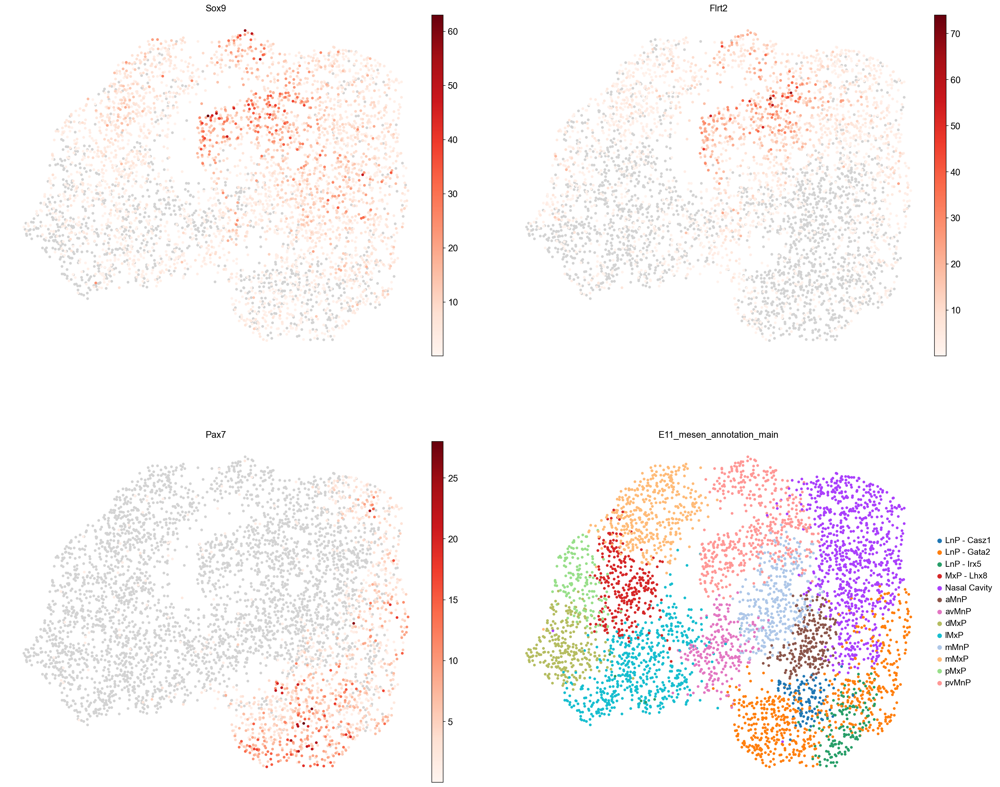

In [8]:
sc.set_figure_params(dpi=70,figsize=[12,10])

sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_umap',
    color=['Sox9','Flrt2','Pax7','E11_mesen_annotation_main'],
    #groups=['Whisker Pad','test'],
    frameon=False,
    ncols=2,
    size = 70,
    cmap = reds,
    vmin=0.01,
)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


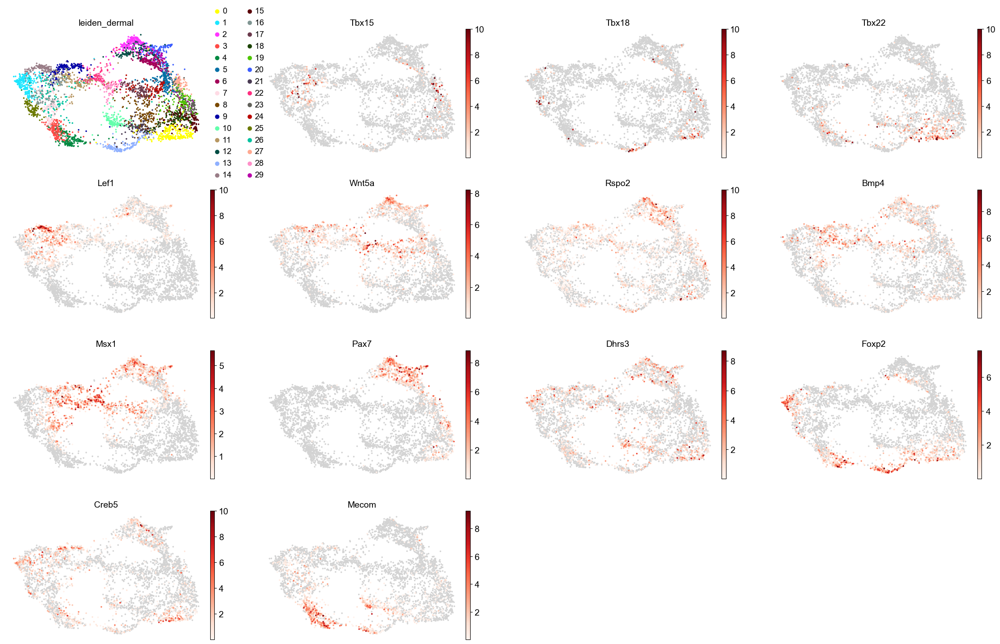

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


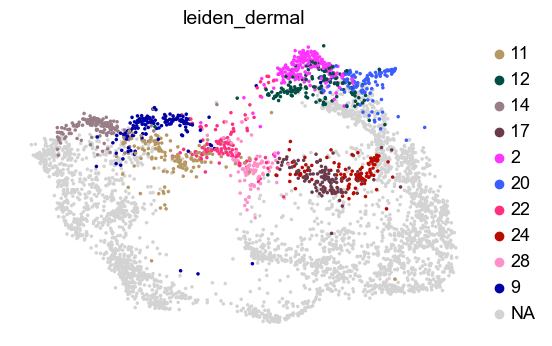

In [86]:
sc.tl.leiden(adata_E11_mesen_filt, resolution = 2.2, key_added = 'leiden_dermal')
sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_MDE',
    color=['leiden_dermal',
           'Tbx15','Tbx18','Tbx22','Lef1','Wnt5a','Rspo2','Bmp4','Msx1','Pax7','Dhrs3','Foxp2','Creb5','Mecom',],
    #groups=['5','10','21'],
    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.01,
)
sc.pl.embedding(
    adata_E11_mesen_filt,
    basis='X_MDE',
    color=['leiden_dermal',],
    groups=['9','11','14','22','2','12','24','17','28','20'],
    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.01,
)

1710504224.263572: Regressing cell cycle
1710504246.4278498: Highly Variable Genes
1710504246.622135: PCA
1710504246.6875324: Neighbors
1710504246.7412152: MDE and UMAP
1710504248.6307433: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


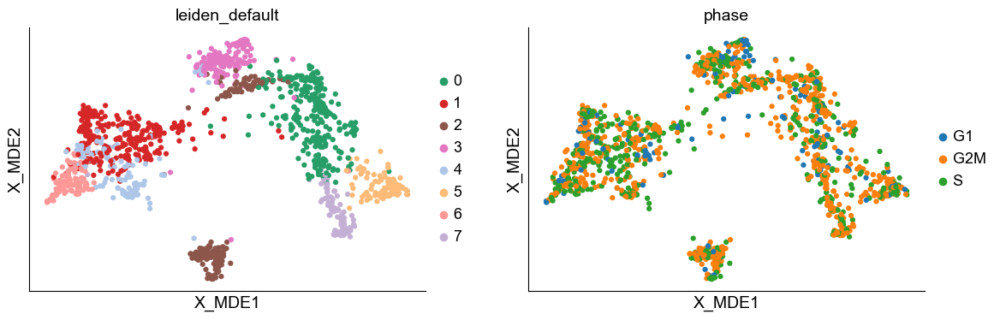

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


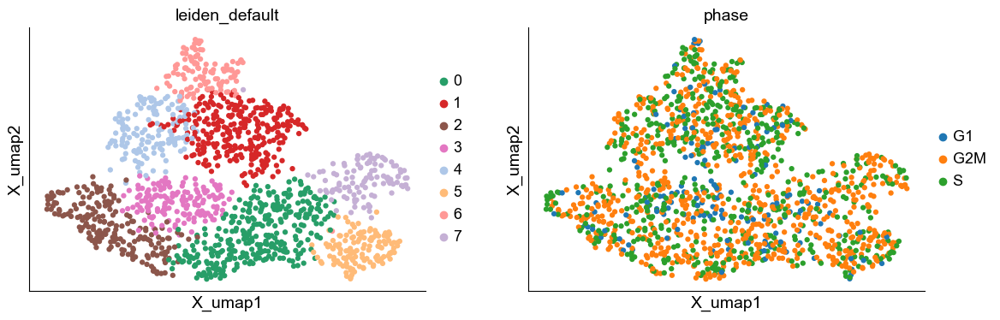

In [81]:
#adata_E11_dermal = adata_E11_mesen_filt[adata_E11_mesen_filt.obs['leiden_dermal'].isin(['9','11','14','22','2','12','24','17','28','20'])].copy()
default_regress_cycle_to_mde(adata_E11_dermal, n_neighbors = 10,n_comps=40, skip_preprocess = True, resolution = .5,n_top_genes = 1500)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


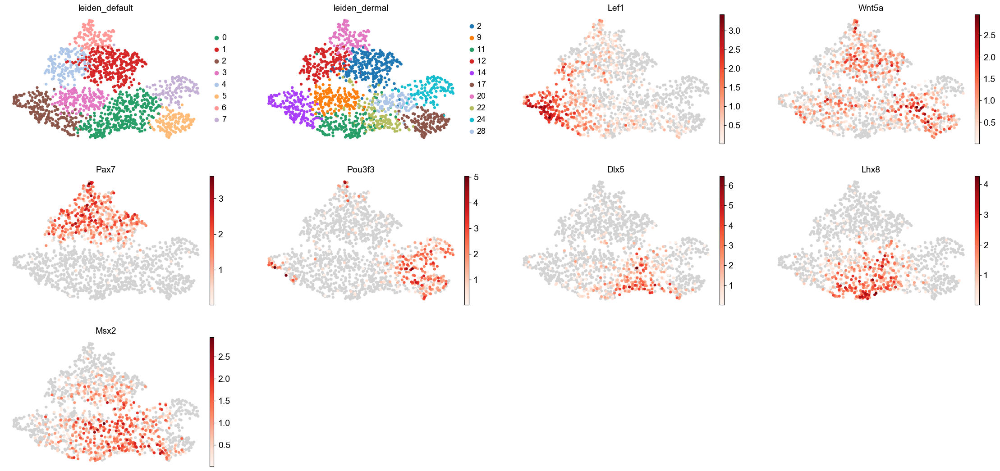

In [87]:
sc.pl.embedding(
    adata_E11_dermal,
    basis='X_umap',
    color=['leiden_default','leiden_dermal','Lef1','Wnt5a','Pax7','Pou3f3','Dlx5','Lhx8','Msx2',],
    #groups=['9','11','14','22','2','12','24','17','28','20'],
    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.01,
)


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


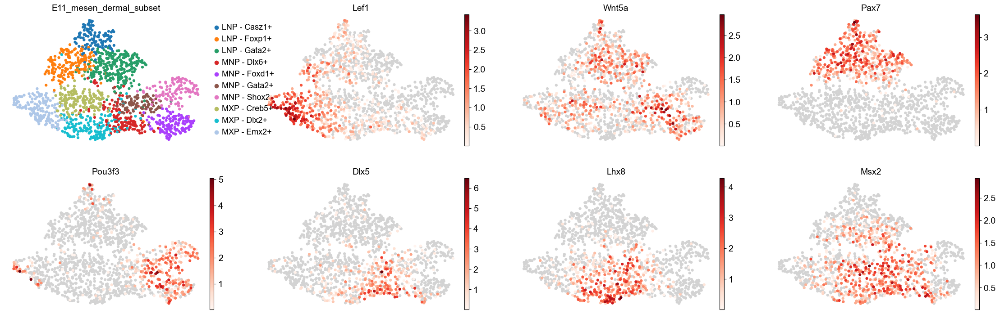

In [98]:
adata_E11_dermal.obs['E11_mesen_dermal_subset'] = 'tmp'


adata_E11_dermal.obs.loc[adata_E11_dermal[adata_E11_dermal.obs['leiden_dermal'] == '2'].obs.index,'E11_mesen_dermal_subset'] = 'LNP - Gata2+' #Pax7 Rnf128 Pax9 Gata2
adata_E11_dermal.obs.loc[adata_E11_dermal[adata_E11_dermal.obs['leiden_dermal'] == '9'].obs.index,'E11_mesen_dermal_subset'] = 'MXP - Creb5+' #Creb5 Tgfb2 Bmper 
adata_E11_dermal.obs.loc[adata_E11_dermal[adata_E11_dermal.obs['leiden_dermal'] == '11'].obs.index,'E11_mesen_dermal_subset'] = 'MXP - Dlx2+' #Lhx8 Dlx2
adata_E11_dermal.obs.loc[adata_E11_dermal[adata_E11_dermal.obs['leiden_dermal'] == '12'].obs.index,'E11_mesen_dermal_subset'] = 'LNP - Foxp1+' #Pax7 Foxp1
adata_E11_dermal.obs.loc[adata_E11_dermal[adata_E11_dermal.obs['leiden_dermal'] == '14'].obs.index,'E11_mesen_dermal_subset'] = 'MXP - Emx2+' #Lef1 Enpp2 Emx2 Runx2
adata_E11_dermal.obs.loc[adata_E11_dermal[adata_E11_dermal.obs['leiden_dermal'] == '17'].obs.index,'E11_mesen_dermal_subset'] = 'MNP - Foxd1+' #Foxd1 Kcnmb2 Tfap2b Cdh10 Lrriq1
adata_E11_dermal.obs.loc[adata_E11_dermal[adata_E11_dermal.obs['leiden_dermal'] == '20'].obs.index,'E11_mesen_dermal_subset'] = 'LNP - Casz1+' #Pax7 Tfap2b Casz1
adata_E11_dermal.obs.loc[adata_E11_dermal[adata_E11_dermal.obs['leiden_dermal'] == '22'].obs.index,'E11_mesen_dermal_subset'] = 'MNP - Dlx6+' #Dlx5 Dlx6 
adata_E11_dermal.obs.loc[adata_E11_dermal[adata_E11_dermal.obs['leiden_dermal'] == '24'].obs.index,'E11_mesen_dermal_subset'] = 'MNP - Shox2' #tfap2b Shox2
adata_E11_dermal.obs.loc[adata_E11_dermal[adata_E11_dermal.obs['leiden_dermal'] == '28'].obs.index,'E11_mesen_dermal_subset'] = 'MNP - Gata2+' #Gata2 Pax9 Flrt2 
adata_E11_dermal.obs['E11_mesen_dermal_subset'] = adata_E11_dermal.obs['E11_mesen_dermal_subset'].astype('category')
sc.pl.embedding(
    adata_E11_dermal,
    basis='X_umap',
    color=['E11_mesen_dermal_subset','Lef1','Wnt5a','Pax7','Pou3f3','Dlx5','Lhx8','Msx2',],
    #groups=['9','11','14','22','2','12','24','17','28','20'],
    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.01,
)


In [99]:
adata_E11_dermal.write('anndata_objects/adata_E11_dermal.h5ad')

In [52]:
###################
###################
###################
####Ectoderm#####

#adata_E11_ecto = adata_E11[adata_E11.obs['leiden_default'].isin(['6','8','11'])].copy()
#default_regress_cycle_to_mde(adata_E11_ecto, n_neighbors = 15,n_comps=20, skip_preprocess = False, resolution = 1.1)
#adata_E11_ecto.write('anndata_objects/adata_E11_ecto.h5ad')
adata_E11_ecto = sc.read('anndata_objects/adata_E11_ecto.h5ad')


1707312916.539367: Highly Variable Genes
1707312916.68304: PCA
1707312916.7186453: Neighbors
1707312916.7533965: MDE and UMAP
1707312918.8244128: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


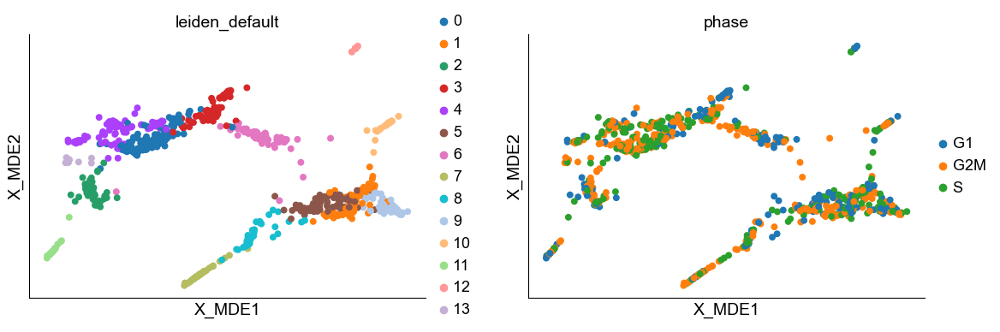

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


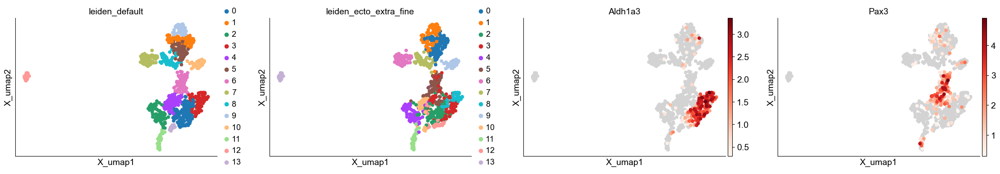

In [125]:

#default_regress_cycle_to_mde(adata_E11_ecto, n_neighbors = 15,n_comps=20, skip_preprocess = False, resolution = 1)
#default_regress_cycle_to_mde(adata_E11_ecto, n_neighbors = 15,n_comps=20, skip_preprocess = True, resolution = 1.1)

sc.pl.embedding(adata_E11_ecto,
               # basis='X_harmony_MDE',
                basis='X_umap',
                color = ['leiden_default','leiden_ecto_extra_fine','Aldh1a3','Pax3',],
           ncols=4, cmap=reds, vmin=0.3)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/sca

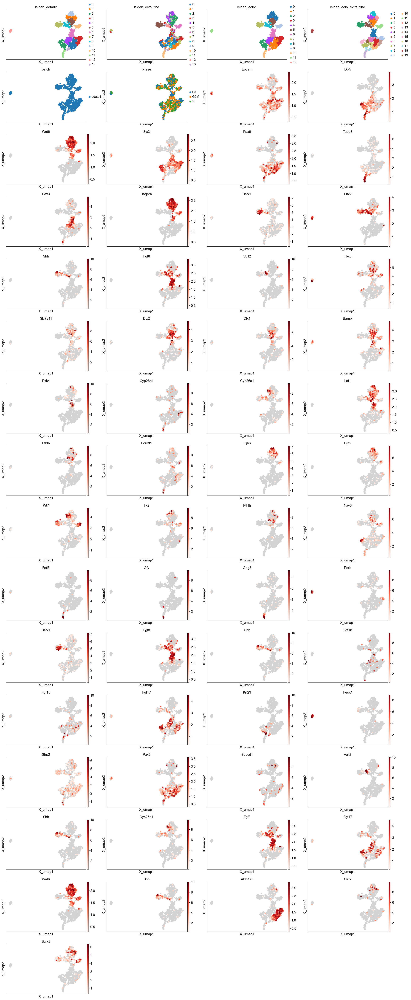

In [45]:
sc.tl.leiden(adata_E11_ecto, resolution = 1, key_added = 'leiden_ecto1')

sc.pl.embedding(adata_E11_ecto,
               # basis='X_harmony_MDE',
                basis='X_umap',
                color = ['leiden_default','leiden_ecto_fine','leiden_ecto1','leiden_ecto_extra_fine','batch','phase','Epcam','Dlx5','Wnt6','Six3','Pax6','Tubb3','Pax3','Tfap2b',
                         'Barx1','Pitx2','Shh','Fgf8','Vgll2','Tbx3','Slc7a11','Dlx2','Dlx1','Bambi','Dkk4','Cyp26b1','Cyp26a1','Lef1','Pthlh','Pou3f1','Gjb6','Gjb2','Krt7','Irx2','Pthlh','Nav3',
                         'Fstl5','Gfy','Gng8','Rorb','Barx1','Fgf8','Shh','Fgf18','Fgf15','Fgf17','Krt23','Hesx1','Sfrp2','Pax6','Sapcd1','Vgll2','Shh','Cyp26a1','Fgf8','Fgf17','Wnt6','Shh','Aldh1a3',
                         'Osr2','Barx2',],
           ncols=4, cmap=reds, vmin=0.3)


#Leiden_default
#11 Split into 2 #Neurog1 Comitted neuronal progenitors #but Fstl5 Gfy Tip Immature Neurons
#13 Neuronal progenitors
#2 Vomeronasal organ
#4 non neural progenitors  Pcp4, maob Otx2
#3 Aldh1a3 Isl1 Lgr5 Respiratory Epithelium
#0 Ventral Olfactory Epithelium
#6 Olfactory pit rim
#8 Dental (shh+ cells are tooth bud, Vgll2+ cell oral ectoderm but not tooth)
#10 Periderm
#7 Barx1 Presumptive Palate
#1, 5, 9 Surface ecto, note split between Dlx1,2+ and Irx4, Hapln1+, also note specific domains of Cyp26a1+, Krt7+ that are Lef1-; Pthlh in the tip is Andrea's presumptive whisker pad

#remove Hesx1 band

#Neurog1 Comitted neuronal progenitors
#but Fstl5 Gfy Tip Immature Neurons
#Ascl1 Insm1 Acsm4 + Neurog1 - Neural progenitors Cluster13 res 1.2
#rest sp8 Olfactory epithelium

#Barx1 palate
#Pitx2 + barx1- dental

#flrt2 fezf2 + Vomeronasal 

#Gabrp+ periderm

#Wnt6 Surface Ectoderm

#'Pax6','Sostdc1','Irx5','Fn1','Dlk1','Krt18','Hesx1','Otx2','Gca','Sp8','Aldh1a3','Pitx2','Pax6','Rax','Vsx2','Pax2','Mitf','Socs2','Six6','Fgf8','Fgf17','Neurog1','Galm',
                       # 'Fgf9','Foxe1','Shh','Zfp750','Rhov','Tgm1','Cxcl14','Wnt9a','Insm1','Ascl1','Acsm4','Kit','Foxa1','Pitx2','Shh','Barx1','Sult1e1','Sox2','Flrt2','Fezf2','Dmrt3',
                        # 'Eya4','P4ha3','Ctxn3','Lgr5','Mgp','Isl1','Runx1','Dusp5','Pcp4','Six2','Maob',

In [51]:
#renaming clusters
adata_E11_ecto.obs['E11_ecto_annotation_coarse'] = adata_E11_ecto.obs['leiden_default'] #create new column
adata_E11_ecto.obs['E11_ecto_annotation_coarse'] = adata_E11_ecto.obs['E11_ecto_annotation_coarse'].cat.add_categories(['Committed Neuronal Progenitors',
                                                                                                                        'Neuronal Progenitors',
                                                                                                                        'Vomeronasal Organ',
                                                                                                                        'Non-neuronal Progenitors',
                                                                                                                        'Respiratory Epithelium',
                                                                                                                        'Ventral Olfactory Epithelium',
                                                                                                                        'Oral Ectoderm',
                                                                                                                        'Periderm',
                                                                                                                        'Olfactory Pit Rim',
                                                                                                                        'Palate Epithelium',
                                                                                                                        'Surface Ectoderm',
                                                                                                                        'Hesx1+ remove',
                                                                                                                       ])#add category names


adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_default'] == '11'].obs.index,'E11_ecto_annotation_coarse'] = 'Committed Neuronal Progenitors'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_default'] == '13'].obs.index,'E11_ecto_annotation_coarse'] = 'Neuronal Progenitors'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_default'] == '2'].obs.index,'E11_ecto_annotation_coarse'] = 'Vomeronasal Organ'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_default'] == '4'].obs.index,'E11_ecto_annotation_coarse'] = 'Non-neuronal Progenitors'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_default'] == '3'].obs.index,'E11_ecto_annotation_coarse'] = 'Respiratory Epithelium'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_default'] == '0'].obs.index,'E11_ecto_annotation_coarse'] = 'Ventral Olfactory Epithelium'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_default'] == '8'].obs.index,'E11_ecto_annotation_coarse'] = 'Oral Ectoderm'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_default'] == '10'].obs.index,'E11_ecto_annotation_coarse'] = 'Periderm'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_default'] == '6'].obs.index,'E11_ecto_annotation_coarse'] = 'Olfactory Pit Rim'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_default'] == '7'].obs.index,'E11_ecto_annotation_coarse'] = 'Palate Epithelium'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_default'] == '1'].obs.index,'E11_ecto_annotation_coarse'] = 'Surface Ectoderm'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_default'] == '5'].obs.index,'E11_ecto_annotation_coarse'] = 'Surface Ectoderm'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_default'] == '9'].obs.index,'E11_ecto_annotation_coarse'] = 'Surface Ectoderm'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_default'] == '12'].obs.index,'E11_ecto_annotation_coarse'] = 'Hesx1+ remove'


adata_E11_ecto.obs['E11_ecto_annotation_coarse'] = adata_E11_ecto.obs['E11_ecto_annotation_coarse'].cat.remove_unused_categories() #remove unused categories

In [52]:
#renaming clusters
adata_E11_ecto.obs['E11_ecto_annotation_fine'] = adata_E11_ecto.obs['leiden_ecto1'] #create new column
adata_E11_ecto.obs['E11_ecto_annotation_fine'] = adata_E11_ecto.obs['E11_ecto_annotation_fine'].cat.add_categories(['Committed Neuronal Progenitors',
                                                                                                                        'Neuronal Progenitors',
                                                                                                                        'Vomeronasal Organ',
                                                                                                                        'Non-neuronal Progenitors',
                                                                                                                        'Respiratory Epithelium',
                                                                                                                        'Ventral Olfactory Epithelium',
                                                                                                                        'Oral Ectoderm',
                                                                                                                        'Periderm',
                                                                                                                        'Olfactory Pit Rim',
                                                                                                                        'Palate Epithelium',
                                                                                                                        'Surface Ectoderm',
                                                                                                                        'Hesx1+ remove',
                                                                                                                    'Immature Neurons',
                                                                                                                    'Surface Ectoderm Dlx1/2 High',
                                                                                                                    'Surface Ectoderm Gjb6/2 High',
                                                                                                                       ])#add category names


adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_ecto1'] == '10'].obs.index,'E11_ecto_annotation_fine'] = 'Committed Neuronal Progenitors'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_ecto1'] == '12'].obs.index,'E11_ecto_annotation_fine'] = 'Neuronal Progenitors'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_ecto1'] == '2'].obs.index,'E11_ecto_annotation_fine'] = 'Vomeronasal Organ'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_ecto1'] == '4'].obs.index,'E11_ecto_annotation_fine'] = 'Non-neuronal Progenitors'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_ecto1'] == '3'].obs.index,'E11_ecto_annotation_fine'] = 'Respiratory Epithelium'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_ecto1'] == '1'].obs.index,'E11_ecto_annotation_fine'] = 'Ventral Olfactory Epithelium'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_ecto1'] == '8'].obs.index,'E11_ecto_annotation_fine'] = 'Oral Ectoderm'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_ecto1'] == '9'].obs.index,'E11_ecto_annotation_fine'] = 'Periderm'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_ecto1'] == '6'].obs.index,'E11_ecto_annotation_fine'] = 'Olfactory Pit Rim'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_ecto1'] == '7'].obs.index,'E11_ecto_annotation_fine'] = 'Palate Epithelium'

adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_ecto1'] == '11'].obs.index,'E11_ecto_annotation_fine'] = 'Hesx1+ remove'

adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_ecto1'] == '5'].obs.index,'E11_ecto_annotation_fine'] = 'Surface Ectoderm Dlx1/2 High'
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_ecto1'] == '0'].obs.index,'E11_ecto_annotation_fine'] = 'Surface Ectoderm Gjb6/2 High'

#label Gfy positive cells in cluster 11 as Immature neurons
clust_subset = adata_E11_ecto[adata_E11_ecto.obs['leiden_ecto1']=='10'] #subset cluster 11
barcode_subset = clust_subset[(clust_subset[:,'Gfy'].layers['original_counts']>0), : ].obs.index #barcodes of cells with Gfy expression in subset


adata_E11_ecto.obs.loc[barcode_subset,'E11_ecto_annotation_fine'] = 'Immature Neurons'



adata_E11_ecto.obs['E11_ecto_annotation_fine'] = adata_E11_ecto.obs['E11_ecto_annotation_fine'].cat.remove_unused_categories() #remove unused categories

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


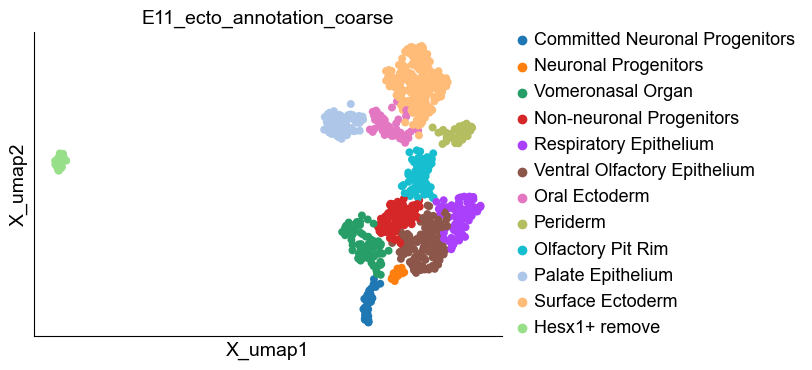

In [101]:
#sc.tl.leiden(adata_E11_ecto, resolution = 3, key_added = 'leiden_ecto_finer')

sc.pl.embedding(adata_E11_ecto,
                # basis='X_harmony_MDE',
                basis='X_umap',
                color = ['E11_ecto_annotation_coarse',],
                ncols=4, cmap=reds, vmin=0.3,)

1710506386.1149418: Regressing cell cycle
1710506400.5777175: Highly Variable Genes
1710506400.634165: PCA
1710506400.663085: Neighbors
1710506400.6716816: MDE and UMAP
1710506401.9955895: Leiden clustering


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


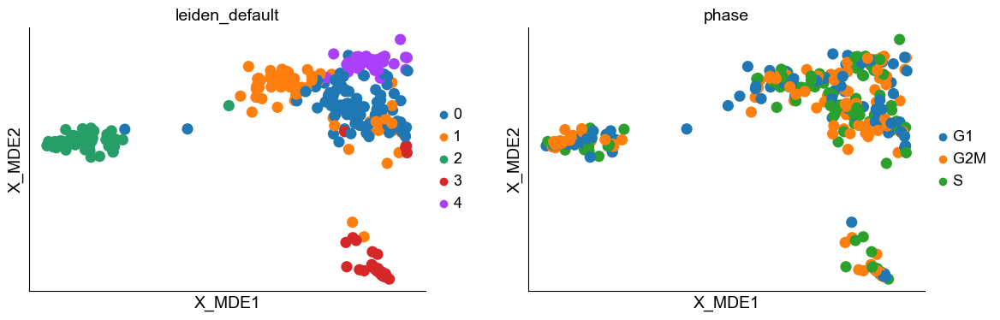

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


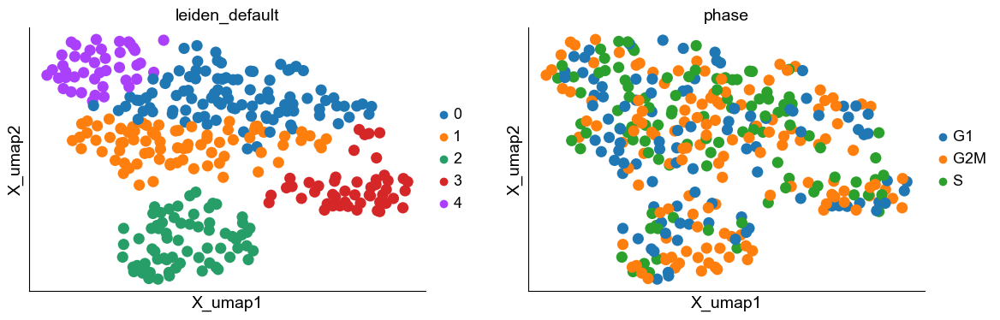

In [102]:
adata_E11_ecto_surface = adata_E11_ecto[adata_E11_ecto.obs['E11_ecto_annotation_coarse'].isin(['Surface Ectoderm','Periderm','Olfactory Pit Rim'])].copy()
default_regress_cycle_to_mde(adata_E11_ecto_surface, n_neighbors = 10,n_comps=40, skip_preprocess = False, resolution = .5,n_top_genes = 1500)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


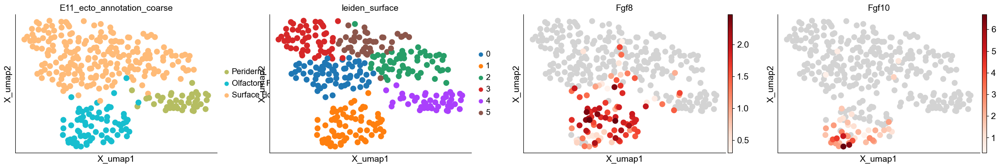

In [104]:
sc.tl.leiden(adata_E11_ecto_surface, resolution = .8, key_added = 'leiden_surface')
sc.pl.embedding(adata_E11_ecto_surface,
                # basis='X_harmony_MDE',
                basis='X_umap',
                color = ['E11_ecto_annotation_coarse','leiden_surface','Fgf8','Fgf10',],
                ncols=4, cmap=reds, vmin=0.3,)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


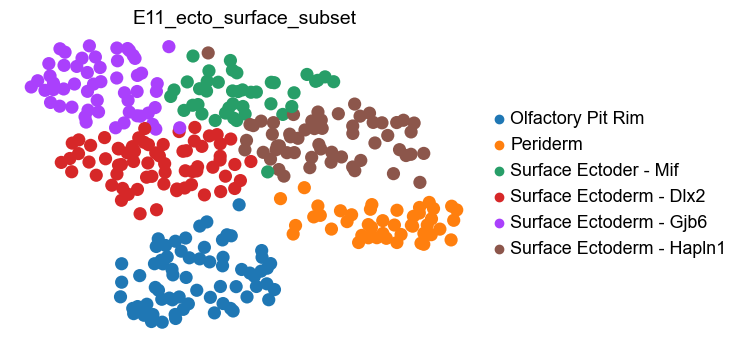

In [111]:
adata_E11_ecto_surface.obs['E11_ecto_surface_subset'] = 'tmp'


adata_E11_ecto_surface.obs.loc[adata_E11_ecto_surface[adata_E11_ecto_surface.obs['leiden_surface'] == '0'].obs.index,'E11_ecto_surface_subset'] = 'Surface Ectoderm - Dlx2' #Dlx2 Bambi Crabp1
adata_E11_ecto_surface.obs.loc[adata_E11_ecto_surface[adata_E11_ecto_surface.obs['leiden_surface'] == '1'].obs.index,'E11_ecto_surface_subset'] = 'Olfactory Pit Rim' #
adata_E11_ecto_surface.obs.loc[adata_E11_ecto_surface[adata_E11_ecto_surface.obs['leiden_surface'] == '2'].obs.index,'E11_ecto_surface_subset'] = 'Surface Ectoderm - Hapln1' #Hapln1 Krt7
adata_E11_ecto_surface.obs.loc[adata_E11_ecto_surface[adata_E11_ecto_surface.obs['leiden_surface'] == '3'].obs.index,'E11_ecto_surface_subset'] = 'Surface Ectoderm - Gjb6' #Wnt7b Gjb6 Irx3
adata_E11_ecto_surface.obs.loc[adata_E11_ecto_surface[adata_E11_ecto_surface.obs['leiden_surface'] == '4'].obs.index,'E11_ecto_surface_subset'] = 'Periderm' #
adata_E11_ecto_surface.obs.loc[adata_E11_ecto_surface[adata_E11_ecto_surface.obs['leiden_surface'] == '5'].obs.index,'E11_ecto_surface_subset'] = 'Surface Ectoder - Mif' #Mif Barx2


adata_E11_ecto_surface.obs['E11_ecto_surface_subset'] = adata_E11_ecto_surface.obs['E11_ecto_surface_subset'].astype('category')
sc.pl.embedding(
    adata_E11_ecto_surface,
    basis='X_umap',
    color=['E11_ecto_surface_subset',],
    #groups=['9','11','14','22','2','12','24','17','28','20'],
    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.01,
)


In [112]:
adata_E11_ecto_surface.write('anndata_objects/adata_E11_surface.h5ad')

In [53]:
adata_E11_ecto = sc.read('anndata_objects/adata_E11_ecto_annotated.h5ad')

In [ ]:
cluster_of_interest = '15'
reference_cluster = '7'
cat_name = 'leiden_ecto_extra_fine'
sc.set_figure_params(dpi=50,figsize=[6,4])

sc.tl.rank_genes_groups(adata_E11_ecto, cat_name, groups=[cluster_of_interest], reference=reference_cluster, method='wilcoxon')
number_of_genes = 200
genes = adata_E11_ecto.uns['rank_genes_groups']['names'][cluster_of_interest][:number_of_genes].tolist()
#genes = ['Msx1','Wnt5a','Aopep','Pantr1','Rasl11b','Trps1','Tcf4','Pou3f3','Nfib','Sox11','Aspn','Efna5','Limch1','Fbn2',]
sc.pl.embedding(
    adata_E11_ecto,
    basis='X_umap',
    color=[cat_name]+genes,
    groups = [cluster_of_interest, reference_cluster],
    frameon=False,
    ncols=4,
    cmap = reds,
    vmin=0.1,
)

In [ ]:
plot_deg_embedding(adata = adata_E11_ecto, 
                   groupby = 'leiden_ecto_extra_fine', 
                   cluster_name = '15', 
                   n_genes = 200, 
                   method = 'wilcoxon',
                   basis = 'X_umap')

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


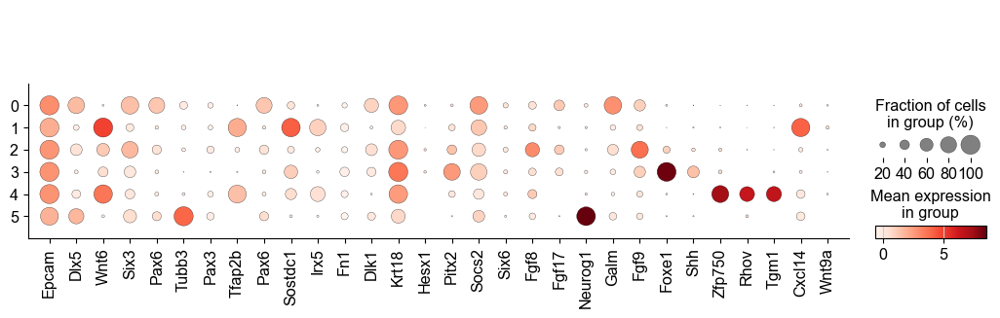

In [39]:
sc.pl.dotplot(adata_E11_ecto, var_names = ['Epcam','Dlx5','Wnt6','Six3','Pax6','Tubb3','Pax3','Tfap2b',
                         'Pax6','Sostdc1','Irx5','Fn1','Dlk1','Krt18','Hesx1','Pitx2','Socs2','Six6','Fgf8','Fgf17','Neurog1','Galm',
                        'Fgf9','Foxe1','Shh','Zfp750','Rhov','Tgm1','Cxcl14','Wnt9a'], groupby = 'leiden_ecto')

In [ ]:
#renaming clusters coarse
adata_E11_ecto.obs['E11_ecto_annotation_coarse'] = adata_E11_ecto.obs['leiden_ecto'] #create new column
adata_E11_ecto.obs['E11_ecto_annotation_coarse'] = adata_E11_ecto.obs['E11_ecto_annotation_coarse'].cat.add_categories([])#add category names

adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_ecto'] == '0'].obs.index,'E11_ecto_annotation_coarse'] = ' ' #Dlx5 Six3 Pax6 Dlk1 Galm
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_ecto'] == '1'].obs.index,'E11_ecto_annotation_coarse'] = ' ' #Wnt6 Sostdc1 Irx5 Cxcl14 Tfap2b Fgfr2
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_ecto'] == '2'].obs.index,'E11_ecto_annotation_coarse'] = ' ' #Six3 Fgf8 Fgf9
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_ecto'] == '3'].obs.index,'E11_ecto_annotation_coarse'] = ' ' #Pitx2 Foxe1 Shh
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_ecto'] == '4'].obs.index,'E11_ecto_annotation_coarse'] = ' ' #Wnt6 Tfap2b Zfp750 Rhov Tgm1
adata_E11_ecto.obs.loc[adata_E11_ecto[adata_E11_ecto.obs['leiden_ecto'] == '5'].obs.index,'E11_ecto_annotation_coarse'] = ' ' #Tubb3 Neurog1 Comitted neuronal progenitors

#remove Hesx1 band

#Neurog1 Comitted neuronal progenitors
#but Fstl5 Gfy Tip Immature Neurons
#Ascl1 Insm1 Acsm4 + Neurog1 - Neural progenitors Cluster13 res 1.2
#rest sp8 Olfactory epithelium

#Barx1 palate
#Pitx2 + barx1- dental

#flrt2 fezf2 + Vomeronasal 

#Gabrp+ periderm

#Wnt6 Surface Ectoderm



adata_E11_ecto.obs['E11_ecto_annotation_coarse'] = adata_E11_ecto.obs['E11_ecto_annotation_coarse'].cat.remove_unused_categories() #remove unused categories

In [ ]:
plot_deg_embedding(adata = adata_E11_ecto, 
                   groupby = 'leiden_ecto_fine', 
                   cluster_name = '3', 
                   n_genes = 200, 
                   method = 'wilcoxon',
                   basis = 'X_umap')